In [3]:
library(dplyr)
library(data.table)
library(stringr)
library(ggplot2)
library(glue)
library(IRdisplay)
library(Matrix)
library(patchwork)
# library(numbat)
library(conos)
devtools::load_all('~/Numbat')


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘data.table’


The following objects are masked from ‘package:dplyr’:

    between, first, last


Loading required package: igraph


Attaching package: ‘igraph’


The following objects are masked from ‘package:dplyr’:

    as_data_frame, groups, union


The following objects are masked from ‘package:stats’:

    decompose, spectrum


The following object is masked from ‘package:base’:

    union


ℹ Loading numbat

Registered S3 method overwritten by 'ggtree':
  method      from 
  identify.gg ggfun

Registered S3 method overwritten by 'vegan':
  method     from      
  rev.hclust dendextend

Warning message:
“replacing previous import ‘Matrix::expand’ by ‘ggtree::expand’ when loading ‘numbat’”


ERROR: Error in parse(text = lines, n = -1, srcfile = srcfile): /home/tenggao/numbat/R/hmm.R:718:12: unexpected symbol
717: 
718:     hmm1$x hmm2
                ^


In [722]:
26913 + 29992

[1] 56905

In [546]:
all_samples = c(paste0('ATC', 1:5), paste0('TNBC', 1:5), c('DCIS1'))
cell_counts = cell_annot[all_samples] %>% lapply(nrow) %>% rbind
cell_counts
sum(unlist(cell_counts))

,ATC1,ATC2,ATC3,ATC4,ATC5,TNBC1,TNBC2,TNBC3,TNBC4,TNBC5,DCIS1
,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
.,2203,6226,3264,1731,6144,1097,1034,532,3056,3225,1480


[1] 29992

In [3]:
res = list()

cell_annot = fread('~/paper_data/cell_annotations/cell_annot_MDA.tsv') %>%
    split(.$sample)

con_TNBC = readRDS('~/external/MDA/conos_TNBC.rds')
con_ATC = readRDS('~/external/MDA/conos_ATC.rds')

In [6]:
# con_BC = readRDS('~/external/MDA/conos_BC.rds')

# Collage

## TvN

method,recall,precision,accuracy
<fct>,<dbl>,<dbl>,<dbl>
Numbat,0.970,0.993,0.984
Numbat-exp,0.970,0.989,0.982
CopyKAT,0.969,0.990,0.981


method,recall,precision,accuracy
<fct>,<dbl>,<dbl>,<dbl>
Numbat,0.927,0.995,0.985
Numbat-exp,0.900,0.988,0.982
CopyKAT,0.937,0.988,0.985


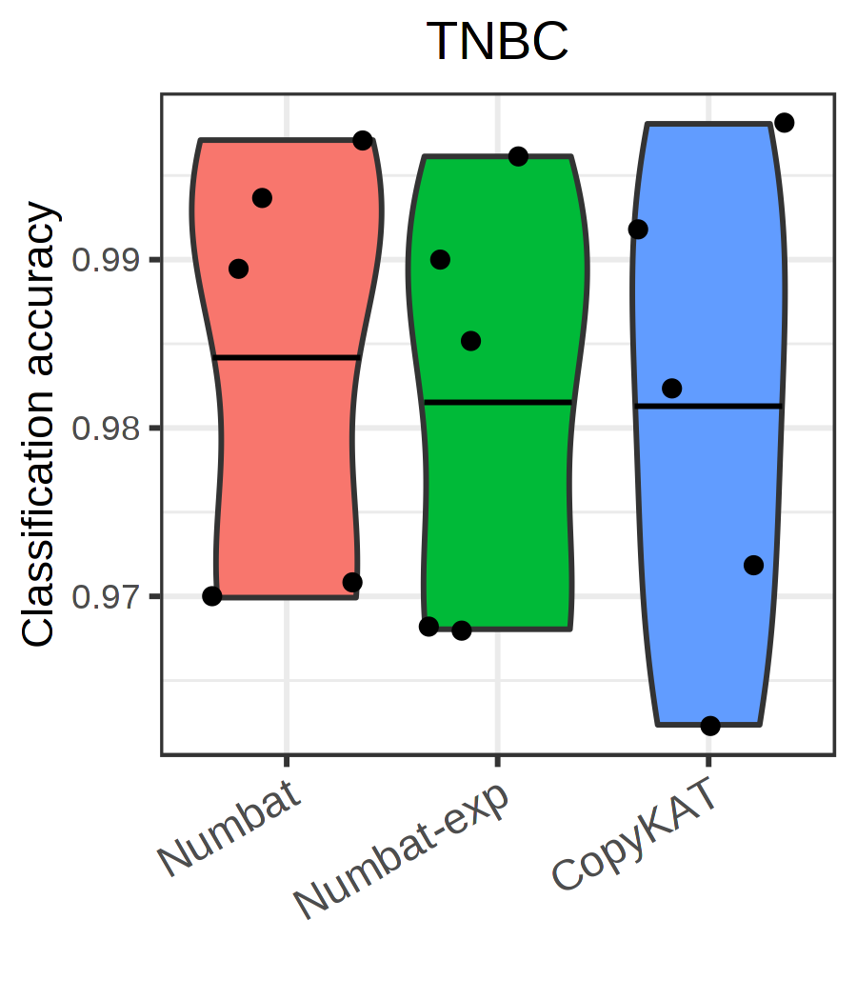

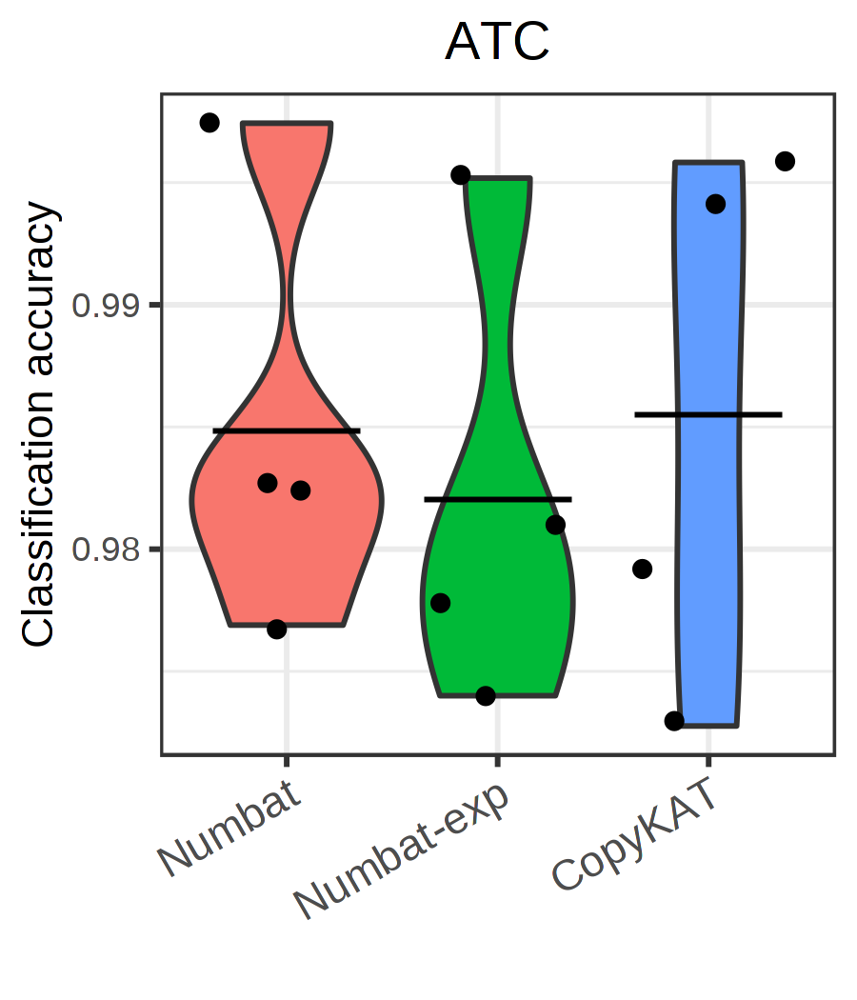

In [127]:
options(repr.plot.width = 3, repr.plot.height = 3.5, repr.plot.res = 300)

datasets = list('TNBC' = paste0('TNBC', 1:5), 'ATC' = paste0('ATC', 1:4))
# datasets = list('ATC' = paste0('ATC', c(1,3:4)))

for (series in names(datasets)) {
    
    clone_post = lapply(
        datasets[[series]], function(sample) {
            fread(glue('~/paper_data/numbat_out/{sample}_new2/clone_post_2.tsv'))
        }
    ) %>%
    bind_rows()

    D = clone_post %>% 
        left_join(bind_rows(cell_annot), by = 'cell') %>%
        mutate(
            p_cnv = ifelse(is.na(p_cnv), 1 - p_1, p_cnv),
            numbat.pred = ifelse(p_cnv > 0.5, 'T', 'N'),
            numbat.exp.pred = ifelse(p_cnv_x > 0.5, 'T', 'N'),
            numbat.allele.pred = ifelse(p_cnv_y > 0.5, 'T', 'N')
        ) %>%
        select(copykat.pred, numbat.pred, numbat.exp.pred, numbat.allele.pred, cluster.pred, sample) %>%
        melt(measure.vars = c('numbat.pred', 'copykat.pred', 'numbat.exp.pred'),
             variable.name = 'method',
             value.name = 'pred') %>%
        mutate(method = c(
            'numbat.pred' = 'Numbat', 'numbat.exp.pred' = 'Numbat-exp', 
            'copykat.pred' = 'CopyKAT')[as.character(method)]
        ) %>%
        mutate(method = factor(method, c('Numbat', 'Numbat-exp', 'CopyKAT'))) %>%
        group_by(sample, method) %>%
        summarise(
            recall = mean(pred[cluster.pred == "T"] == "T"),
            precision = mean(cluster.pred[pred == "T"] == "T"),
            accuracy = mean(pred == cluster.pred),
            .groups = 'drop'
        )

    p = ggplot(
            D,
            aes(x = method, y = accuracy, fill = method)
        ) +
        geom_violin(
#             draw_quantiles = c(0.5)
        ) +
        geom_jitter() +
        stat_summary(fun=mean, geom="crossbar", size = 0.2, width = 0.7) +
        theme_bw() +
        ylab('Classification accuracy') +
        xlab('') +
        ggtitle(series) +
        theme(
            plot.title = element_text(hjust = 0.5),
            legend.position = 'none',
            axis.text.x = element_text(size = 11, angle = 30, hjust = 1)
        )
    
    display(p)

    D %>%
    group_by(method) %>%
    summarise_at(
        c('recall', 'precision', 'accuracy'),
        function(x){signif(mean(x),3)}
    ) %>%
    display
}

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will rep

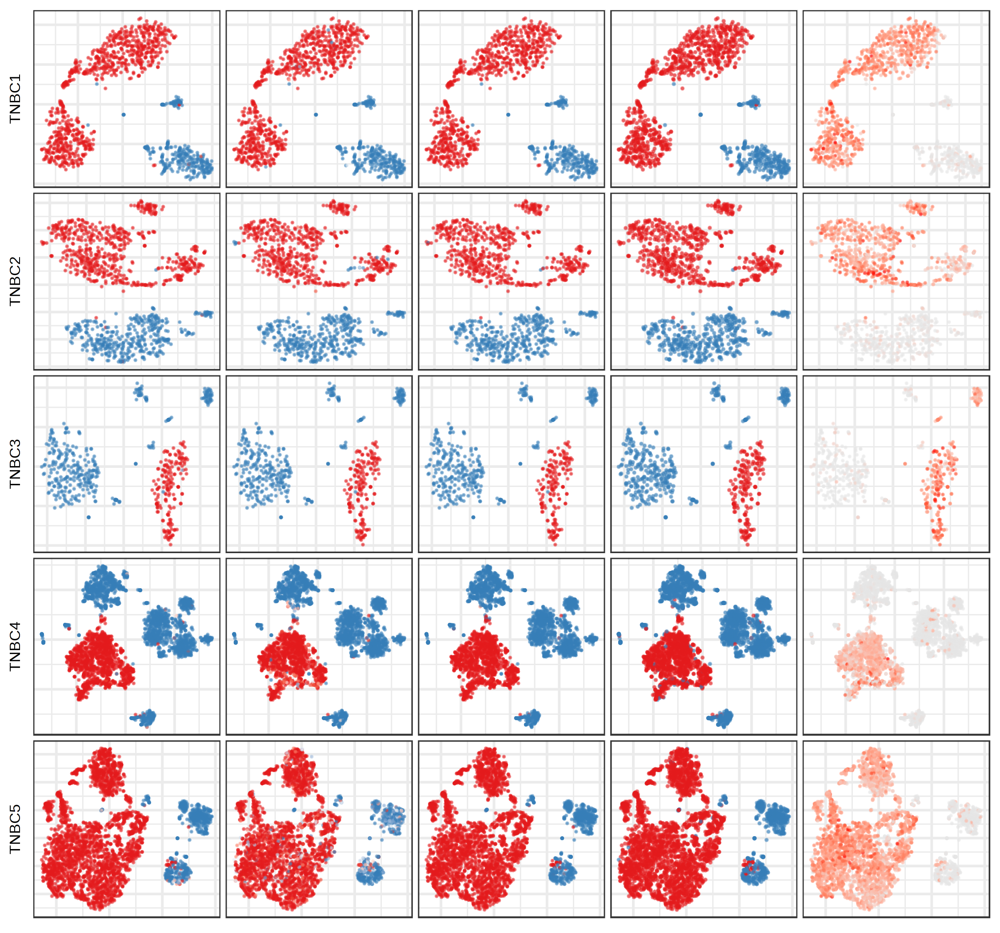

In [106]:
options(repr.plot.width = 7.5, repr.plot.height = 7, repr.plot.res = 300)

joint_plots = list()
copykat_plots = list()
exp_plots = list()
allele_plots = list()
marker_plots = list()
samples = c(paste0('TNBC', 1:5))

for (sample in samples) {
    
    if (str_detect(sample, 'ATC')) {
        con = con_ATC
    } else {
        con = con_TNBC
    }

    marker = ifelse(str_detect(sample, 'ATC'), 'KRT8', 'EPCAM')
    
    clone_post = fread(glue('~/paper_data/numbat_out/{sample}_new/clone_post_2.tsv'))
    
    cell_clusters = con$samples[[sample]]$clusters$PCA$multilevel
    cell_clusters = cell_clusters[names(cell_clusters) %in% cell_annot[[sample]]$cell]

    marker_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        plot.na = F,
        groups = cell_clusters,
        plot.theme = theme_bw(),
        gene = marker,
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    )
    
    exp_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        colors = cell_annot[[sample]] %>% 
            left_join(clone_post, by = 'cell') %>%
            {setNames(.$p_cnv_x, .$cell)},
        show.legend = F,
        mark.groups = T,
        plot.na = F,
        plot.theme = theme_bw(),
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0),
        axis.title.y = element_text(size = 8)
    ) +
    scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish) +
    ylab(sample)
    
    allele_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        colors = cell_annot[[sample]] %>% 
            left_join(clone_post, by = 'cell') %>%
            {setNames(.$p_cnv_y, .$cell)},
        show.legend = F,
        mark.groups = T,
        plot.na = F,
        plot.theme = theme_bw(),
    #         title = sample,
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    ) +
    scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)
    
    joint_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        colors = cell_annot[[sample]] %>% 
            left_join(clone_post, by = 'cell') %>%
            {setNames(.$p_cnv, .$cell)},
        show.legend = F,
        mark.groups = T,
        plot.na = F,
        plot.theme = theme_bw(),
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    ) +
    scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)
    
    
    copykat_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.2, 
        groups = cell_annot[[sample]] %>%
            {setNames(.$copykat.pred, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.na = F,
        plot.theme = theme_bw(),
        pal = c(pal[2], pal[1])
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    )
    
}

wrap_plots(c(rbind(exp_plots, allele_plots, joint_plots, copykat_plots, marker_plots)), ncol = 5, byrow = T)

## Phylogenies

In [6]:
res = list()

In [178]:
R.utils::sourceDirectory('~/Numbat/R')


In [179]:
for (sample in c(paste0('ATC', 5))) {
    message(sample)
    out_dir = glue('~/paper_data/numbat_out/{sample}_new')
    nb[[sample]] = Numbat$new(out_dir, i = 2)
}

ATC5



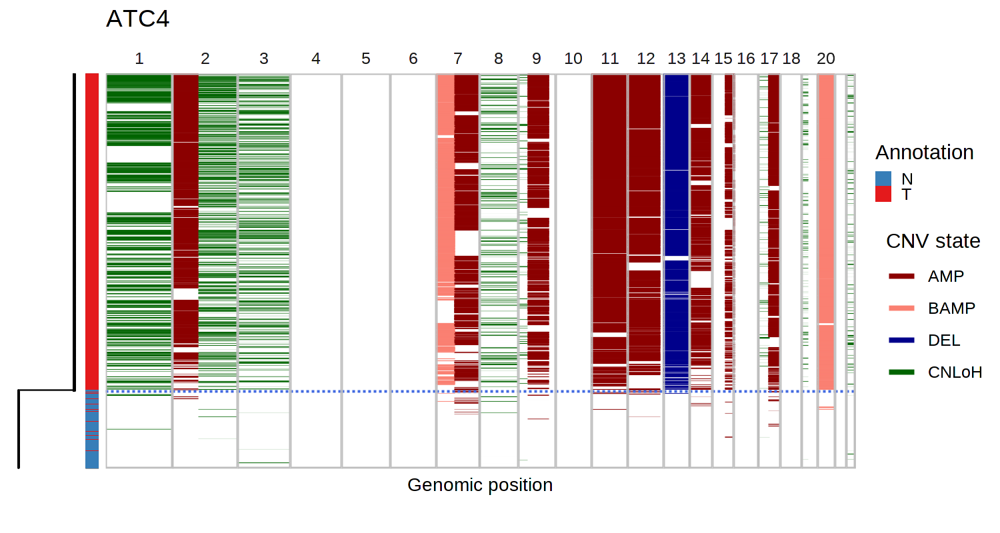

In [823]:
options(repr.plot.width = 7.5, repr.plot.height = 4, repr.plot.res = 200)

for (sample in paste0('ATC', 4)) {
    
    p = plot_phylo_heatmap(
        nb[[sample]]$gtree,
        nb[[sample]]$joint_post,
        nb[[sample]]$segs_consensus,
        annot = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
        clone_legend = F,
#         tip_length = 1,
        tip_length = 0.1,
        branch_width = 0.3,
        line_width = 0.15,
        tree_height = 1.25,
        pal_annot = c(pal[2], pal[1])
    ) + ggtitle(sample) &
    theme(plot.background = element_rect(fill = "transparent", color = NA))
    
    print(p)
    
#     ggsave(glue("~/figures/{sample}_phylogeny.png"), p, bg = "transparent", width = 7.5, height = 4, dpi = 300)
}

# mtRNA

In [1777]:
mt_samples = c('TNBC1', 'TNBC2', 'TNBC5', 'ATC1', 'ATC2_subsampled')
samples = c(paste0('TNBC',1:5), 'ATC2_subsampled', 'ATC1', paste0('ATC', 3:5))

for (sample in c('ATC1', 'TNBC5', 'TNBC1')) {
    message(sample)
    out_dir = glue('~/paper_data/numbat_out/{sample}_new')
    nb[[sample]] = Numbat$new(out_dir, i = 2, old_index = FALSE)
}

nb[['ATC2']] = nb[['ATC2_subsampled']] 

ATC1

TNBC5

TNBC1



In [249]:
VAF = list()

for (sample in c('TNBC1', 'TNBC2', 'TNBC5', 'ATC1', 'ATC2')) {
    AD = readMM(glue('~/paper_data/mtRNA/mquad/{sample}/passed_ad.mtx')) %>% as.matrix
    DP = readMM(glue('~/paper_data/mtRNA/mquad/{sample}/passed_dp.mtx')) %>% as.matrix
    cells = fread(glue('~/external/MDA/{sample}_barcodes.tsv'), header = F)$V1
    cells = paste0(sample, '_', cells)
    variants = fread(glue('~/paper_data/mtRNA/mquad/{sample}/passed_variant_names.txt'), header = F)$V1
    VAF[[sample]] = AD/DP
    colnames(VAF[[sample]]) = cells
    rownames(VAF[[sample]]) = variants
    colnames(DP) = cells
    rownames(DP) = variants
    
    VAF[[sample]] = VAF[[sample]] %>%
        reshape2::melt() %>% 
        setNames(c('variant', 'cell', 'VAF')) %>%
        left_join(
            DP %>%
                reshape2::melt() %>% 
                setNames(c('variant', 'cell', 'DP')),
            by = c("variant", "cell")
        )
}

In [310]:
clones = lapply(
     c('TNBC1', 'ATC2', 'TNBC5', 'ATC1'),
    function(sample) {
        if (sample == 'TNBC5') {
            clones = nb[[sample]]$clone_post %>%
                mutate(clone_opt = case_when(
                    clone_opt == 1 ~ 'Normal',
                    clone_opt %in% 2 ~ 'Truncal',
                    clone_opt %in% 6:12 ~ 'Major',
                    clone_opt %in% 3:5 ~ 'Minor'
                ))
        } else if (sample %in% 'ATC1') {
            clones = nb[[sample]]$clone_post %>%
                mutate(clone_opt = case_when(
                    clone_opt == 1 ~ 'Normal',
                    clone_opt %in% 2 ~ 'Truncal',
                    clone_opt %in% 4 ~ 'Major',
                    clone_opt %in% 3 ~ 'Minor'
                ))
        } else if (sample == 'TNBC1') {
            clones = nb[[sample]]$clone_post %>%
                mutate(clone_opt = case_when(
                    clone_opt == 1 ~ 'Normal',
                    clone_opt %in% 2 ~ 'Truncal',
                    clone_opt %in% 4 ~ 'Major',
                    clone_opt %in% 3 ~ 'Minor'
                ))
        } else {
            clones = nb[[sample]]$clone_post %>%
                mutate(clone_opt = case_when(
                    clone_opt == 1 ~ 'Normal',
                    T ~ as.character(as.integer(as.factor(clone_opt)))
                ))
        }
        clones = clones %>% mutate(sample = sample)
    }
) %>% 
bind_rows()

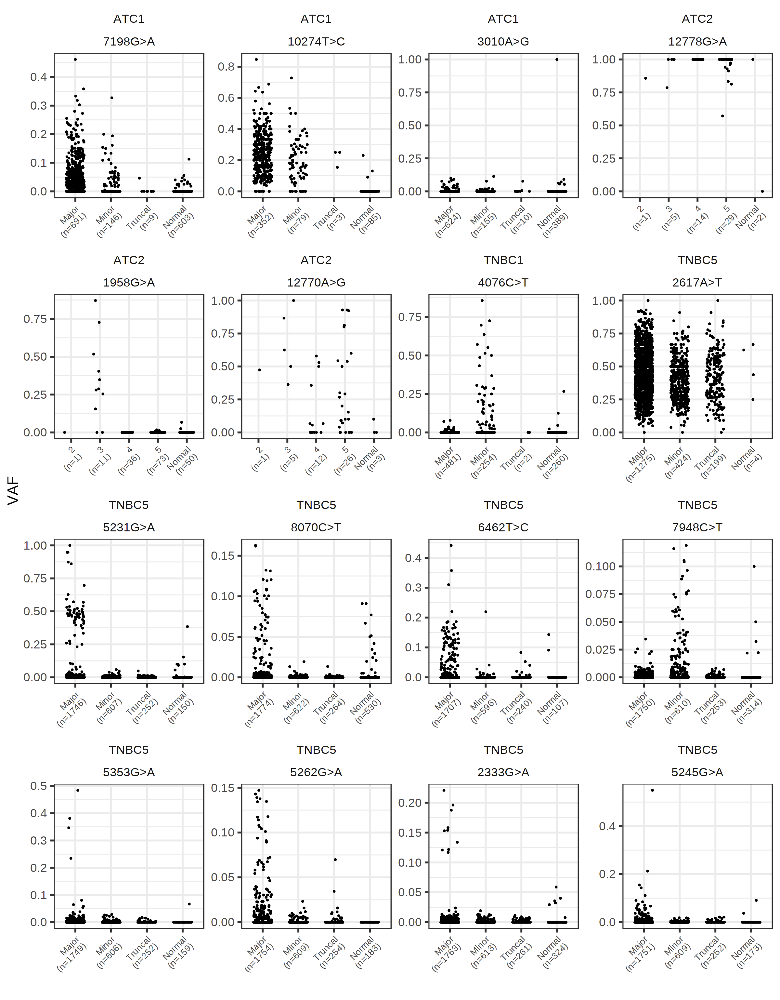

In [372]:
options(repr.plot.width = 8, repr.plot.height = 10.25, repr.plot.res = 300)

bind_rows(VAF) %>% 
    left_join(
        bind_rows(cell_annot),
        by = 'cell'
    ) %>%
    inner_join(
        clones,
        by = c('cell', 'sample')
    ) %>%
    group_by(variant, sample) %>%
    filter(sum(VAF[cluster.pred == 'T'] > 0.05, na.rm = T) > 5) %>%
    filter(DP >= 10) %>%
    group_by(variant, clone_opt, sample) %>%
    mutate(clone_opt = paste0(clone_opt, '\n(n=', n(), ')')) %>%
    ungroup() %>%
    arrange(sample, str_detect(clone_opt, 'Normal'), clone_opt) %>%
    mutate(clone_opt = factor(clone_opt, unique(clone_opt))) %>%
    ggplot(
        aes(x = clone_opt, y = VAF)
    ) +
    geom_jitter(size = 0.1, width = 0.25) +
    theme_bw() +
    theme(
        strip.background = element_blank(),
        axis.text.x = element_text(angle = 45, hjust = 1, vjust = 1, size = 6.5)
    ) +
    facet_wrap(~sample+variant, scale = 'free') +
    xlab('')

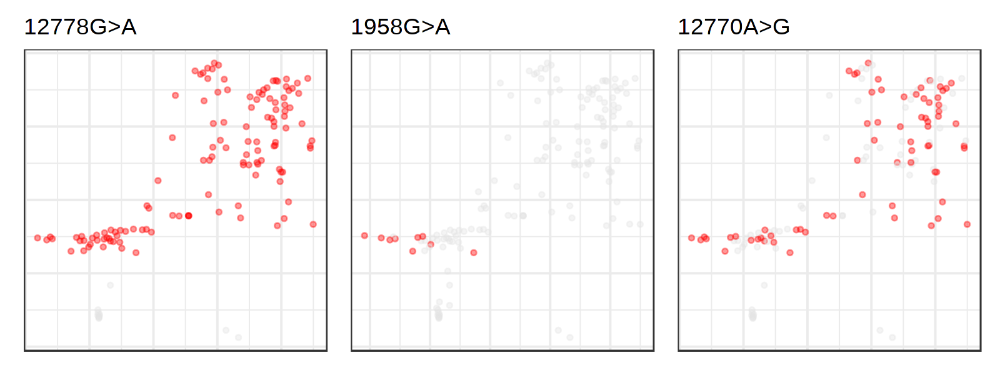

In [319]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)

sample = 'ATC2'

cells = cell_annot[[sample]] %>% filter(cluster.pred == 'T') %>% pull(cell)

lapply(
    VAF[[sample]] %>% 
        filter(cell %in% cells) %>%
        group_by(variant) %>%
        filter(sum(VAF > 0.15, na.rm = T) > 3) %>%
        ungroup() %>%
        mutate(variant = factor(variant)) %>%
        split(.$variant),
    function(VAF) {
        con_ATC$samples[[sample]]$plotEmbedding(
            colors = VAF %>% {setNames(as.integer(.$VAF > 0.1), .$cell)},
            plot.na = F,
            size = 1,
            title = unique(VAF$variant)
        )
    }
) %>% 
wrap_plots()

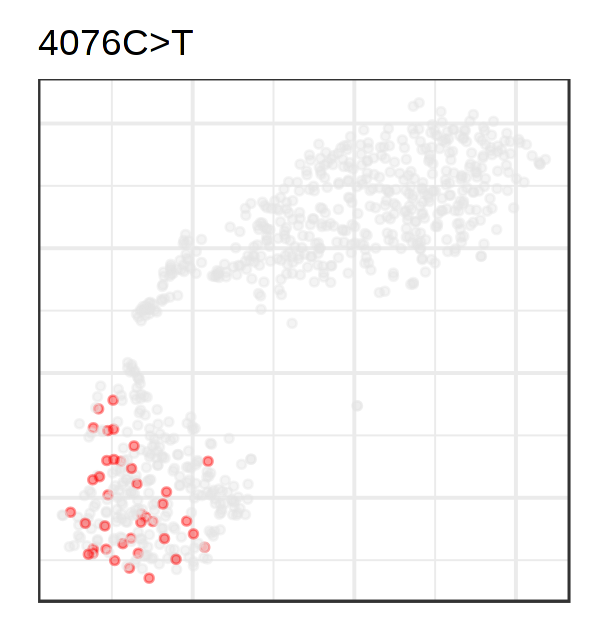

In [317]:
options(repr.plot.width = 3, repr.plot.height = 3.2, repr.plot.res = 200)

sample = 'TNBC1'

cells = cell_annot[[sample]] %>% filter(cluster.pred == 'T') %>% pull(cell)

lapply(
    VAF[[sample]] %>% 
        filter(cell %in% cells) %>%
        group_by(variant) %>%
        filter(sum(VAF > 0.15, na.rm = T) > 3) %>%
        ungroup() %>%
        mutate(variant = factor(variant)) %>%
        split(.$variant),
    function(VAF) {
        con_TNBC$samples[[sample]]$plotEmbedding(
            colors = VAF %>% {setNames(as.integer(.$VAF > 0.1), .$cell)},
            plot.na = F,
            size = 1,
            title = unique(VAF$variant)
        )
    }
) %>% 
wrap_plots()

In [784]:
sample = 'ATC1'

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



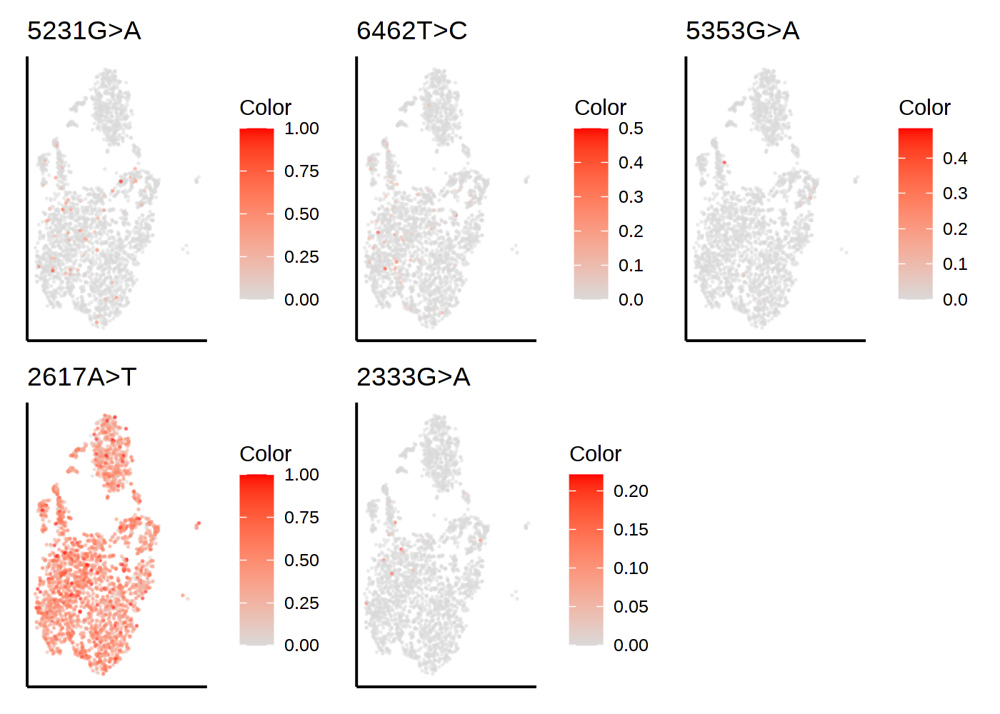

In [216]:
options(repr.plot.width = 7, repr.plot.height = 5, repr.plot.res = 200)

sample = 'TNBC5'
cells = cell_annot[[sample]] %>% filter(cluster.pred == 'T') %>% pull(cell)

lapply(
    VAF[[sample]] %>% 
        filter(cell %in% cells) %>%
        group_by(variant) %>%
        filter(sum(VAF > 0.15, na.rm = T) > 3) %>%
        ungroup() %>%
        mutate(variant = factor(variant)) %>%
        split(.$variant),
    function(VAF) {
        con_TNBC$samples[[sample]]$plotEmbedding(
            colors = VAF %>% {setNames(.$VAF, .$cell)},
            plot.na = F,
            size = 0.05,
            title = unique(VAF$variant),
            plot.theme = theme_classic(),
            show.legend = T
        ) +
        scale_color_gradient(low = 'gray85', high = 'red')
    }
) %>% 
wrap_plots()

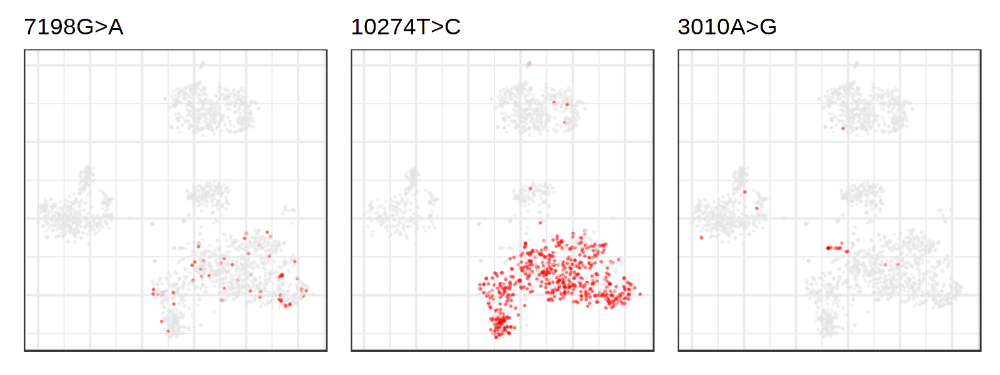

In [217]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)

sample = 'ATC1'

lapply(
    VAF[[sample]] %>% 
        group_by(variant) %>%
        filter(sum(VAF > 0.1, na.rm = T) > 3) %>%
        ungroup() %>%
        mutate(variant = factor(variant)) %>%
        split(.$variant),
    function(VAF) {
        con_ATC$samples[[sample]]$plotEmbedding(
            colors = VAF %>% {setNames(as.integer(.$VAF > 0.15), .$cell)},
            plot.na = F,
            size = 0.1,
            title = unique(VAF$variant)
        )
    }
) %>% 
wrap_plots()

# Calling clones

In [816]:
all_samples = c('ATC1', 'ATC2_subsampled', paste0('ATC', 3:5), paste0('TNBC', 1:5), c('DCIS1'))

for (sample in all_samples) {
    message(sample)
    out_dir = glue('~/paper_data/numbat_out/{sample}_new')
    nb[[sample]] = Numbat$new(out_dir, i = 2, old_index = FALSE)
}

ATC1

Warning message in data.table::fread(input):
“Previous fread() session was not cleaned up properly. Cleaned up ok at the beginning of this fread() call.”
ATC2

ATC3

ATC4

ATC5

TNBC1

TNBC2

TNBC3

TNBC4

TNBC5

DCIS1



In [1341]:
R.utils::sourceDirectory('~/Numbat/R')

for (sample in samples) {
    
    message(sample)
    
    nb[[sample]]$gtree = nb[[sample]]$gtree %>% annot_superclones(nb[[sample]]$geno, precision_cutoff = 0.9)

    superclone_dict = nb[[sample]]$gtree %>% as.data.frame() %>% count(GT, superclone) %>% {setNames(.$superclone, .$GT)}

    nb[[sample]]$mut_graph = nb[[sample]]$mut_graph %>%
        as_tbl_graph %>% 
        mutate(superclone = superclone_dict[GT]) %>%
        mutate(superclone = ifelse(is.na(superclone), 1, superclone)) %>%
        mutate(clone = superclone)
    
}

TNBC1

TNBC2

TNBC3

TNBC4

TNBC5

ATC2_subsampled

ATC1

ATC3

ATC4

ATC5



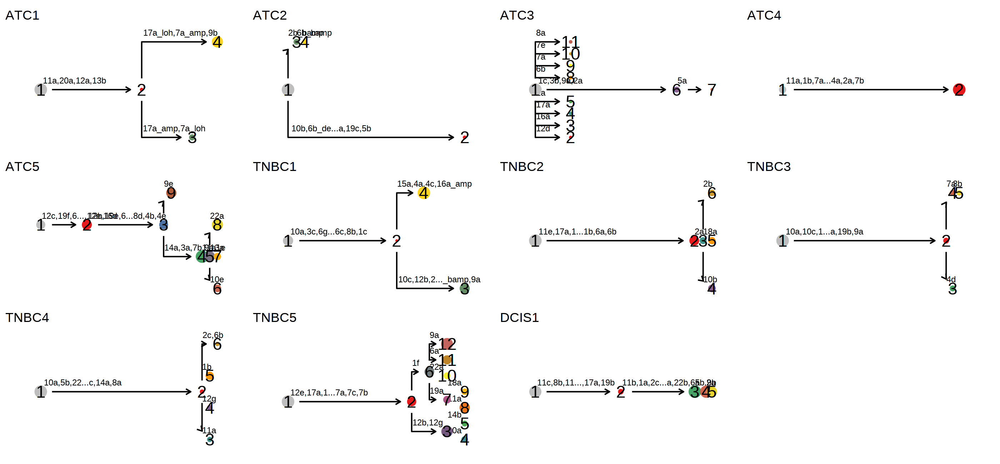

In [832]:
options(repr.plot.width = 14, repr.plot.height = 6.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

lapply(
    all_samples,
    function(sample) {
        nb[[sample]]$plot_mut_history(edge_label_size = 3, node_size = 5, legend = FALSE) + ggtitle(sample)
}) %>% 
wrap_plots(nrow = 3)

# DCIS1

In [53]:
nb = list()

In [54]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC2'
out_dir = glue('~/paper_data/numbat_out/{sample}_new')
nb[[sample]] = Numbat$new(out_dir, i = 2)

In [1292]:
get_desc = function(gtree, v) {
    par = gtree %>%
        activate(nodes) %>%
        mutate(seq = bfs_rank(root = v)) %>%
        filter(!is.na(seq) & leaf) %>%
        pull(name)
}

compute_w = function(P, cells_1, cells_2) {
    sum((colMeans(P[cells_1,]) - colMeans(P[cells_2,]))^2)
}

compute_z = function(P, cells_1, cells_2) {
    N = length(c(cells_1, cells_2))
    n = length(cells_1)
    m = length(cells_2)
    sigma = sqrt(apply(P[c(cells_1, cells_2),], 2, 'var'))
    sigma_d = sqrt((sigma^2/n)*((N-n)/(N-1)) + (sigma^2/m)*((N-m)/(N-1)))
    sum((colMeans(P[cells_1,]) - colMeans(P[cells_2,]))^2/sigma_d^2)
}

compute_d = function(P, cells_1, cells_2) {
    sum(abs(colMeans(P[cells_1,]) - colMeans(P[cells_2,])))
}

permute_d = function(P, cells_1, cells_2, n = 1000) {
    P = P[rownames(P) %in% c(cells_1, cells_2),]
    replicate(n = n, {
        rownames(P) = sample(rownames(P))
        d = compute_d(P, cells_1, cells_2)
    })
}

permute_w = function(P, cells_1, cells_2, n = 1000) {
    P = P[rownames(P) %in% c(cells_1, cells_2),]
    replicate(n = n, {
        rownames(P) = sample(rownames(P))
        w = compute_w(P, cells_1, cells_2)
    })
}

p_w = function(gtree, P, from_node, to_node, sites = NULL, n = 1000, plot = FALSE) {
    
    gtree = gtree %>% activate(nodes)
    
    # from root
    if (is.na(from_node)) {
        from_node = gtree %>% filter(root) %>% pull(name)
    }
    
    from_node = gtree %>% filter(name == from_node) %>% pull(id)
    to_node = gtree %>% filter(name == to_node) %>% pull(id)
    
    cells_1 = get_desc(gtree, from_node)
    cells_2 = get_desc(gtree, to_node)

    cells_1 = cells_1[!cells_1 %in% cells_2]
    
    z = compute_z(P, cells_1, cells_2)
    d = compute_d(P, cells_1, cells_2)
#     d_samples = permute_d(P, cells_1, cells_2, n = n)

#     if (plot) {
        
#         p = ggplot(
#                 data.frame(
#                     w = w_samples
#                 ),
#                 aes(x = w)
#             ) +
#             geom_histogram() +
#             geom_vline(xintercept = w_obs, color = 'red') +
#             ggtitle(sites)
        
#         print(p)
#     }
    
#     pval = sum(w_samples >= w_obs)/n
    
    return(tibble(z, d))
}

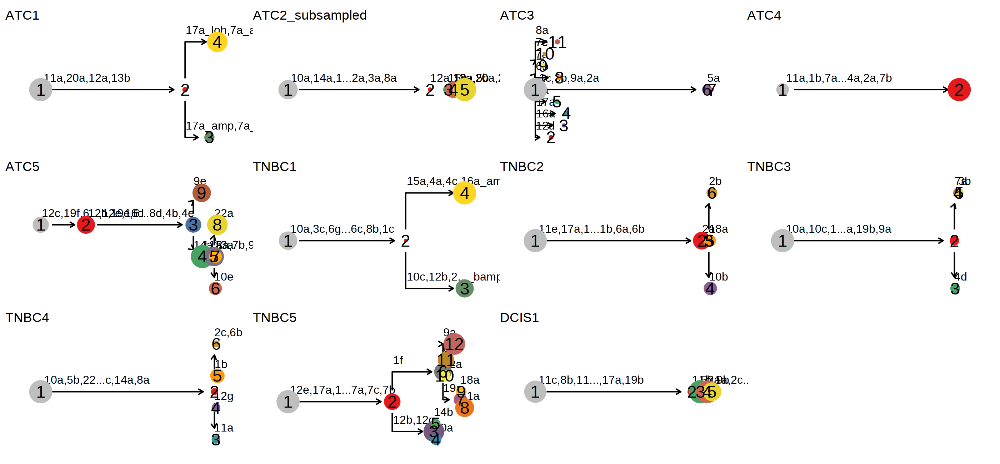

In [1602]:
options(repr.plot.width = 14, repr.plot.height = 6.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plots = lapply(
    all_samples,
    function(sample) {
        P = nb[[sample]]$geno
        gtree = nb[[sample]]$gtree
        G = nb[[sample]]$mut_graph

        edge_scores = G %>% igraph::as_data_frame('edges') %>%
            rowwise() %>%
            mutate(p_w(gtree, P, from_node, to_node, to_label, plot = FALSE, n = 10)) %>%
            ungroup() %>%
            mutate(rank = rank(-z))

    #     E(G)$to_label = edge_scores$rank

        E(G)$length = edge_scores$z

        G %>% plot_mut_history(clone_post = nb[[sample]]$clone_post, show_distance = TRUE, legend = F) + ggtitle(sample)
    }
)

wrap_plots(plots)

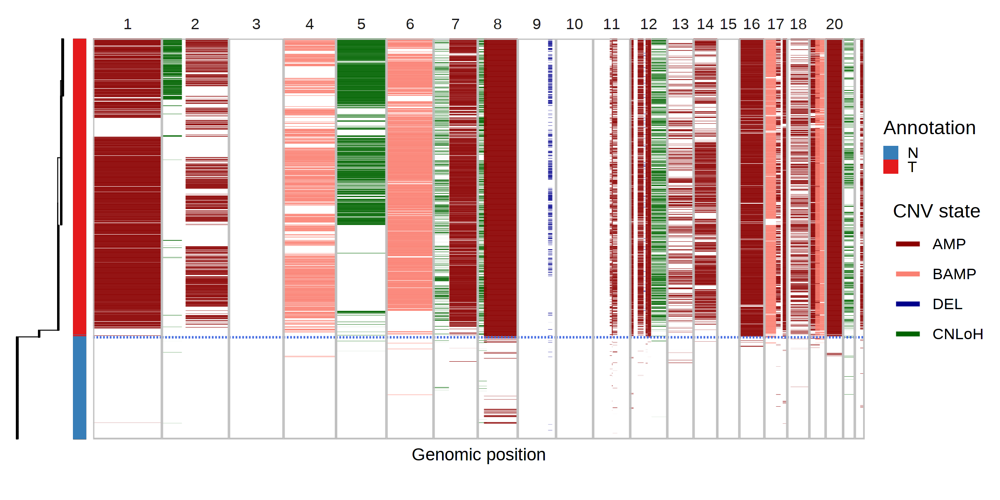

In [74]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'DCIS1'
nb[[sample]]$plot_phylo_heatmap(
    tip_length = 1,
    branch_width = 0.2,
    line_width = 0.075,
    p_min = 0.9,
    pal_annot = c(pal[2], pal[1]),
    annot = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)}
)

In [591]:
copykat.cna = fread('~/paper_data/copykat_out/DCIS1/DCIS1_copykat_CNA_results.txt') %>%
    rename(CHROM = chrom, POS = chrompos)

In [621]:
sample = 'DCIS1'

copykat.pred = fread('~/paper_data/copykat_out/DCIS1/DCIS1_copykat_prediction.txt') %>% 
    rename(cell = cell.names, pred = copykat.pred)

copykat.cna.long = copykat.cna %>% 
    filter(CHROM != 23) %>%
    reshape2::melt(id.var = c('CHROM', 'POS'), variable.name = 'cell', value.name = 'score') %>%
    mutate(cell = str_replace(cell, '\\.', '-')) %>%
    left_join(copykat.pred, by = 'cell')

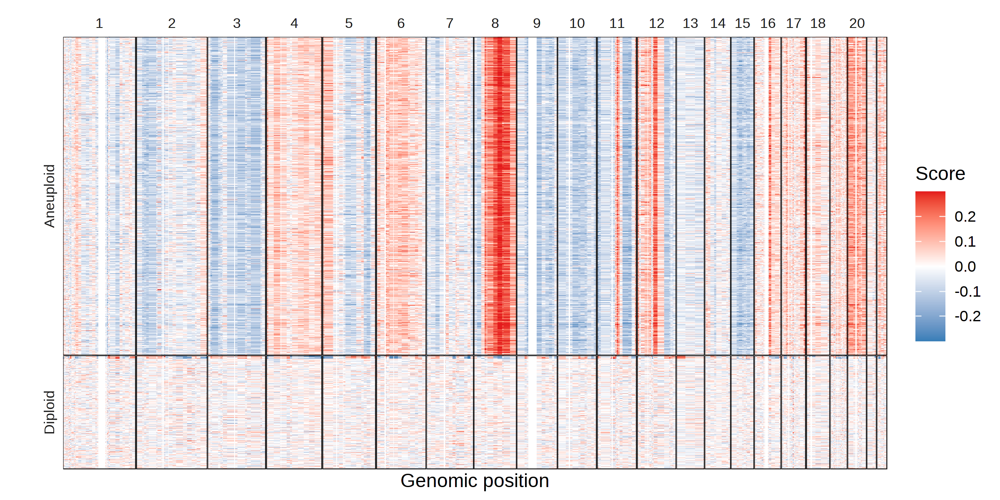

In [638]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 300)

chrom_labeller <- function(chr){
        # chr[as.integer(chr) %% 2 == 0] = ''
        chr[chr %in% c(19, 21, 22)] = ''
        return(chr)
    }

copykat.cna.long %>%
filter(!is.na(pred)) %>%
# filter(cell %in% sample(unique(cell), 50)) %>%
mutate(pred = str_to_title(pred)) %>%
ggplot(
    aes(x = POS, y = cell, fill = score)
) +
xlab('Genomic position') +
ylab('') +
geom_tile() +
theme_classic() +
scale_y_discrete(expand = expansion(0)) +
scale_x_discrete(expand = expansion(add = 0.5)) +
theme(
    panel.spacing = unit(0.1, 'mm'),
    axis.line.x = element_blank(),
    axis.line.y = element_blank(),
    axis.ticks = element_blank(),
    panel.border = element_rect(color = 'black', size = 0.2, fill = NA),
    panel.background = element_rect(fill = 'white'),
    strip.background = element_blank(),
    axis.text = element_blank(),
    strip.text = element_text(angle = 0, size = 8)
) +
scale_fill_gradient2(low = pal[2], high = pal[1], midpoint = 0, limits = c(-0.3, 0.3), oob = scales::oob_squish, name = 'Score') +
facet_grid(pred~CHROM, scale = 'free', space = 'free', labeller = labeller(CHROM = chrom_labeller), switch = 'y')

### CNV Color legend

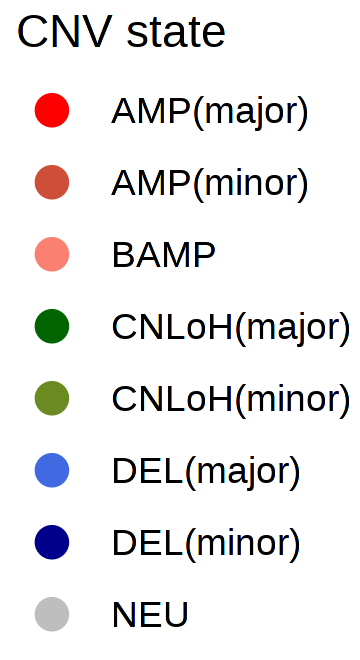

In [636]:
options(repr.plot.width = 1.2, repr.plot.height = 2.2, repr.plot.res = 300)

p = data.frame(
    state = c('AMP_up', 'AMP_down', 'DEL_up', 'DEL_down', 'CNLoH_up', 'CNLoH_down', 'NEU', 'BAMP')
) %>%
mutate(
    state = state %>% str_replace('_up', '(major)') %>% 
        str_replace('_down', '(minor)')
) %>%
ggplot(
    aes(x = state, y = state, color = state)
) +
geom_point() +
scale_color_manual(values = setNames(cnv_colors, names(cnv_colors) %>% 
    str_replace('_up', '(major)') %>% 
    str_replace('_down', '(minor)') %>%
    str_replace('loh', 'CNLoH') %>%
    str_replace('bamp', 'BAMP') %>%
    str_replace('amp', 'AMP') %>%
    str_replace('del', 'DEL') %>%
    str_replace('neu', 'NEU')
)) +
theme_classic() +
guides(color = guide_legend(override.aes = aes(size = 3), title = 'CNV state'))

get_legend(p) %>% as_ggplot

Warning message:
“Using alpha for a discrete variable is not advised.”


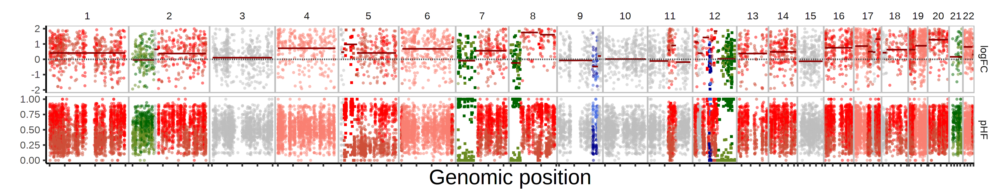

In [2426]:
options(repr.plot.width = 12, repr.plot.height = 2.35, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'DCIS1'
nb[[sample]]$bulk_subtrees %>% 
filter(sample %in% c(3)) %>% 
plot_psbulk(phi_mle = T, legend = F, use_pos = TRUE) +
theme(axis.title.x = element_text(size = 18))

# TNBC1

In [74]:
nb = list()

In [1422]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC2'
out_dir = glue('~/paper_data/numbat_out/{sample}_new')
nb[[sample]] = Numbat$new(out_dir, i = 2)

In [143]:
chrs = c(1,2,3)

In [32]:
R.utils::sourceDirectory('~/Numbat/R')

clone_post = get_clone_post(
    nb[[sample]]$gtree, 
    nb[[sample]]$exp_post,
    nb[[sample]]$allele_post
)

In [44]:
gtree = nb[[sample]]$gtree
exp_post = nb[[sample]]$exp_post 
allele_post = nb[[sample]]$allele_post

In [1423]:
R.utils::sourceDirectory('~/Numbat/R')
sample = 'ATC2_test'
out_dir = glue('~/ATC2_test')
nb[[sample]] = Numbat$new(out_dir, i = 2)

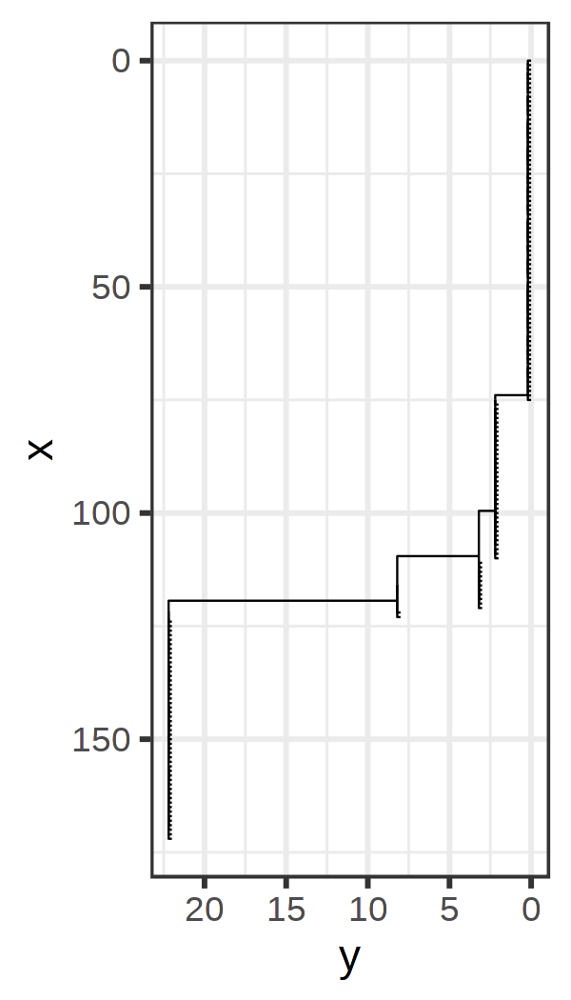

In [740]:
sample = 'ATC2_test'
gtree = nb[[sample]]$gtree

gtree %>% 
    ggraph(
        layout = 'dendrogram',
        length = length
    ) +
    geom_edge_elbow(edge_width = 0.2) +
    coord_flip() +
    scale_y_reverse() +
    scale_x_reverse() +
    theme_bw()

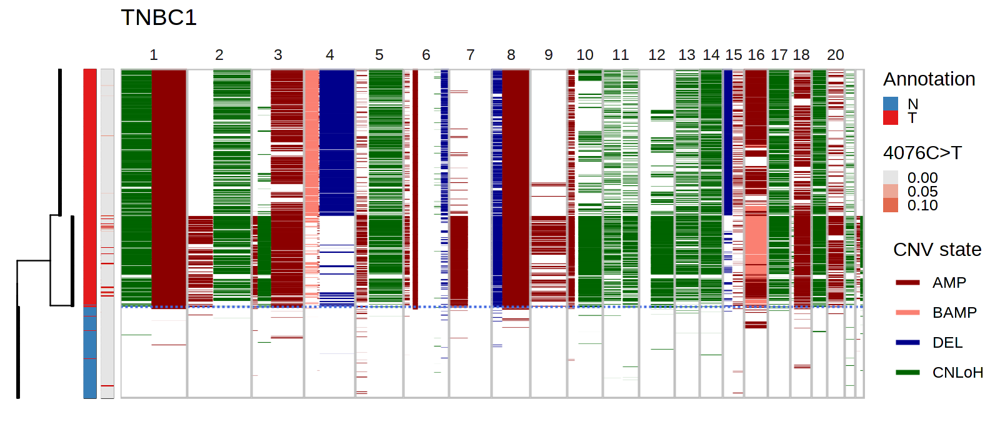

In [279]:
options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC1'
var = '4076C>T'

getPalette = colorRampPalette(pal)

p = plot_phylo_heatmap(
        nb[[sample]]$gtree, 
        nb[[sample]]$joint_post,
        nb[[sample]]$segs_consensus,
        annot = VAF[[sample]] %>% 
            filter(variant == var) %>%
            mutate(VAF = ifelse(DP < 10, NA, VAF)) %>%
            {setNames(.$VAF, .$cell)},
        annot_scale = scale_fill_gradient(low = 'gray90', high = 'red3', limits = c(0, 0.15), na.value = 'gray90', oob = scales::squish),
        clone_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
        pal_annot = c('1' = 'red3'),
        annot_title = var,
        pal_clone = c(pal[2], pal[1]),
        tip_length = 1,
        branch_width = 0.3,
        line_width = 0.15,
        geno_title = 'Annotation',
        tree_height = 1.25,
        geno_bar = TRUE
    ) +
    theme(axis.title.x = element_blank()) +
    ggtitle(sample) & 
    theme(plot.background = element_rect(fill = "transparent", color = NA)) 

ggsave(glue("~/figures/{sample}_phylogeny.png"), p, bg = "transparent", width = 8, height = 3.5, dpi = 300)

p

In [1272]:
library(tidygraph)
library(ggraph)

In [1280]:
con = readRDS(glue('~/paper_data/conos_objects/conos_TNBC.rds'))

In [1426]:
library(numbat)


Attaching package: ‘numbat’


The following objects are masked _by_ ‘.GlobalEnv’:

    aggregate_counts, analyze_bulk, get_bulk, Numbat, plot_bulks,
    plot_consensus, plot_exp_roll, plot_mut_history,
    plot_phylo_heatmap, plot_psbulk, plot_sc_tree, ref_hca, run_numbat




In [1474]:
# count_mat = list()
# df = list()
for (sample in c('TNBC2')) {
    count_mat[[sample]] = t(con$samples[[sample]]$misc$rawCounts)
    df_allele[[sample]] = fread(glue('~/paper_data/processed/{sample}_allele_counts.tsv.gz'), sep = '\t')
}

sample = 'ATC2_test'
count_mat[[sample]] = count_mat_ATC2
df_allele[[sample]] = df_allele_ATC2

In [2157]:
sample = 'ATC2_test'

G = nb[[sample]]$mut_graph
from_node = E(G)$from_node
to_node = E(G)$to_node
LLRs = list()

# for (i in 1:length(E(G))) {
for (i in 1) {
    
    message(i)
    
    bulks = test_branch(
        count_mat[[sample]], 
        df_allele[[sample]],
        nb[[sample]]$gtree,
        nb[[sample]]$segs_consensus, 
        from_node[i], 
        to_node[i], 
        ncores = 30)

#     LLRs[[i]] = compare_bulks(bulks, nb[[sample]]$segs_consensus, ncores = 30)

}

1



In [2158]:
R.utils::sourceDirectory('~/Numbat/R')

bulks = run_group_hmms(bulks, ncores = 10)

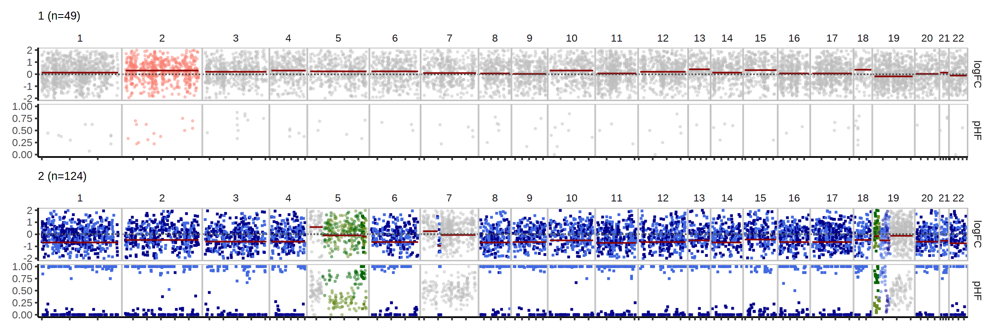

In [2159]:
options(repr.plot.width = 12, repr.plot.height = 4, repr.plot.res = 200)

bulks %>% plot_bulks()

In [2160]:
bulks_unified = bulks %>%
    arrange(sample) %>%
    mutate(sample = as.integer(factor(sample, unique(sample)))) %>%
    select(-phi_mle) %>%
    arrange(CHROM, POS) %>%
    mutate(snp_index = as.integer(factor(snp_id, unique(snp_id)))) %>%
    group_by(CHROM) %>%
    ungroup() %>%
    select(sample, CHROM, POS, snp_id, snp_index, cM, pAD, DP, Y_obs, p_s, mu, sig, d_obs, lambda_ref) %>%
    tidyr::pivot_wider(names_from = "sample", "values_from" = c("pAD", "DP", "Y_obs", "mu", "sig", "d_obs", "lambda_ref")) %>%
    mutate(
        inter_snp_cm = c(NA, cM[2:length(cM)] - cM[1:(length(cM)-1)]),
        p_s = switch_prob_cm(inter_snp_cm),
        p_s_1 = ifelse(is.na(pAD_1), 0, p_s),
        p_s_2 = ifelse(is.na(pAD_2), 0, p_s)
    )

In [2173]:
R.utils::sourceDirectory('~/Numbat/R')

logphi_min = 0.6226686
theta_min = 0.4640317

hmm1 = bulks_unified %>% filter(CHROM == 1) %>%
    {get_joint_hmm(
        pAD = .$pAD_1,
        DP = .$DP_1, 
        Y_obs = .$Y_obs_1, 
        d_total = na.omit(unique(.$d_obs_1)),
        p_s = .$p_s,
        lambda_ref = .$lambda_ref_1, 
        phi_amp = 2^(logphi_min),
        phi_del = 2^(-logphi_min),
        mu = .$mu_1,
        sig = .$sig_1,
        t = t,
        gamma = gamma,
        theta_min = theta_min
    )}

hmm2 = bulks_unified %>% filter(CHROM == 1) %>%
    {get_joint_hmm(
        pAD = .$pAD_2,
        DP = .$DP_2, 
        Y_obs = .$Y_obs_2, 
        d_total = na.omit(unique(.$d_obs_2)),
        p_s = .$p_s,
        lambda_ref = .$lambda_ref_2, 
        phi_amp = 2^(logphi_min),
        phi_del = 2^(-logphi_min),
        mu = .$mu_2,
        sig = .$sig_2,
        t = t,
        gamma = gamma,
        theta_min = theta_min
    )}

In [2164]:
nb[[sample]]$segs_consensus %>% filter(CHROM == 1) %>% select(phi_mle, theta_mle)

phi_mle,theta_mle
<dbl>,<dbl>
0.6226686,0.4640317


In [1690]:
res1 = viterbi_joint2(hmm_merged)

In [2215]:
R.utils::sourceDirectory('~/Numbat/R')

hmm_equal = merge_hmm(hmm2, hmm2, kernel = 'equal')
res0 = viterbi_joint2(hmm_merged)

In [2216]:
R.utils::sourceDirectory('~/Numbat/R')

hmm_phase = merge_hmm(hmm2, hmm2, kernel = 'phase')
res1 = viterbi_joint2(hmm_merged)

In [2200]:
all.equal(res0$z, res1$z)

[1] TRUE

In [2222]:
equal

[1]   1  17  33  49  65  81  97 113 129 145 161 177 193 209 225

In [2227]:
hmm1$logPi_phase[,,3]

0,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0,0
0,-0.0006646549,-7.3165748463,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0,0
0,-7.3165748463,-0.0006646549,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0,0
0,0.0000000000,0.0000000000,-0.0006646549,-7.3165748463,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0,0
0,0.0000000000,0.0000000000,-7.3165748463,-0.0006646549,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0,0
0,0.0000000000,0.0000000000,0.0000000000,0.0000000000,-0.0006646549,-7.3165748463,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0,0
0,0.0000000000,0.0000000000,0.0000000000,0.0000000000,-7.3165748463,-0.0006646549,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0,0
0,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,-0.0006646549,-7.3165748463,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0,0
0,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,-7.3165748463,-0.0006646549,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0,0
0,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,-0.0006646549,-7.3165748463,0.0000000000,0.0000000000,0,0
0,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,0.0000000000,-7.3165748463,-0.0006646549,0.0000000000,0.0000000000,0,0


In [2223]:
hmm_phase$logPi[,,3][equal,equal]

-0.002001001,-16.012801801,-16.012801801,-62.064503661,-62.064503661,-16.012801801,-16.012801801,-62.064503661,-62.064503661,-16.012801801,-16.012801801,-62.064503661,-62.064503661,-35.819776906,-63.450798022
-17.399096162,-0.002665656,-7.318575847,-62.065168316,-69.381078507,-16.013466456,-23.329376647,-62.065168316,-69.381078507,-16.013466456,-23.329376647,-62.065168316,-69.381078507,-35.819776906,-63.450798022
-17.399096162,-7.318575847,-0.002665656,-69.381078507,-62.065168316,-23.329376647,-16.013466456,-69.381078507,-62.065168316,-23.329376647,-16.013466456,-69.381078507,-62.065168316,-35.819776906,-63.450798022
-17.974443641,-16.588813935,-23.904724126,-0.002665656,-7.318575847,-16.588813935,-23.904724126,-62.640515795,-69.956425986,-16.588813935,-23.904724126,-62.640515795,-69.956425986,-36.395124385,-64.026145501
-17.974443641,-23.904724126,-16.588813935,-7.318575847,-0.002665656,-23.904724126,-16.588813935,-69.956425986,-62.640515795,-23.904724126,-16.588813935,-69.956425986,-62.640515795,-36.395124385,-64.026145501
-17.399096162,-16.013466456,-23.329376647,-62.065168316,-69.381078507,-0.002665656,-7.318575847,-62.065168316,-69.381078507,-16.013466456,-23.329376647,-62.065168316,-69.381078507,-35.819776906,-63.450798022
-17.399096162,-23.329376647,-16.013466456,-69.381078507,-62.065168316,-7.318575847,-0.002665656,-69.381078507,-62.065168316,-23.329376647,-16.013466456,-69.381078507,-62.065168316,-35.819776906,-63.450798022
-17.974443641,-16.588813935,-23.904724126,-62.640515795,-69.956425986,-16.588813935,-23.904724126,-0.002665656,-7.318575847,-16.588813935,-23.904724126,-62.640515795,-69.956425986,-36.395124385,-64.026145501
-17.974443641,-23.904724126,-16.588813935,-69.956425986,-62.640515795,-23.904724126,-16.588813935,-7.318575847,-0.002665656,-23.904724126,-16.588813935,-69.956425986,-62.640515795,-36.395124385,-64.026145501
-17.399096162,-16.013466456,-23.329376647,-62.065168316,-69.381078507,-16.013466456,-23.329376647,-62.065168316,-69.381078507,-0.002665656,-7.318575847,-62.065168316,-69.381078507,-35.819776906,-63.450798022
-17.399096162,-23.329376647,-16.013466456,-69.381078507,-62.065168316,-23.329376647,-16.013466456,-69.381078507,-62.065168316,-7.318575847,-0.002665656,-69.381078507,-62.065168316,-35.819776906,-63.450798022


In [2220]:
hmm_equal$logPi[,,3]

-0.002001001,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-34.433482545,-62.064503661
-16.012801801,-0.002665656,-7.318575847,-63.450798022,-63.450798022,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-34.433482545,-62.064503661
-16.012801801,-7.318575847,-0.002665656,-63.450798022,-63.450798022,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-34.433482545,-62.064503661
-16.588149280,-17.974443641,-17.974443641,-0.002665656,-7.318575847,-17.974443641,-17.974443641,-64.026145501,-64.026145501,-17.974443641,-17.974443641,-64.026145501,-64.026145501,-35.008830024,-62.639851140
-16.588149280,-17.974443641,-17.974443641,-7.318575847,-0.002665656,-17.974443641,-17.974443641,-64.026145501,-64.026145501,-17.974443641,-17.974443641,-64.026145501,-64.026145501,-35.008830024,-62.639851140
-16.012801801,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-0.002665656,-7.318575847,-63.450798022,-63.450798022,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-34.433482545,-62.064503661
-16.012801801,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-7.318575847,-0.002665656,-63.450798022,-63.450798022,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-34.433482545,-62.064503661
-16.588149280,-17.974443641,-17.974443641,-64.026145501,-64.026145501,-17.974443641,-17.974443641,-0.002665656,-7.318575847,-17.974443641,-17.974443641,-64.026145501,-64.026145501,-35.008830024,-62.639851140
-16.588149280,-17.974443641,-17.974443641,-64.026145501,-64.026145501,-17.974443641,-17.974443641,-7.318575847,-0.002665656,-17.974443641,-17.974443641,-64.026145501,-64.026145501,-35.008830024,-62.639851140
-16.012801801,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-0.002665656,-7.318575847,-63.450798022,-63.450798022,-34.433482545,-62.064503661
-16.012801801,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-17.399096162,-17.399096162,-63.450798022,-63.450798022,-7.318575847,-0.002665656,-63.450798022,-63.450798022,-34.433482545,-62.064503661


In [2213]:
res0$LL

[1] -15190.83

In [2187]:
res1$LL - res0$LL

[1] -25.42985

In [ ]:
hmm_merged

In [2167]:
res0$LL
res1$LL

[1] -12584.83

[1] -12584.83

In [2060]:
states_expand = cross(paste(states[,1], states[,2], sep = ','), paste(states[,1], states[,2], sep = ','))

In [2069]:
state_labels = paste(states[,1], states[,2], sep = ',')
logPi = hmm_merged$logPi[,,1]
colnames(logPi) = state_labels
rownames(logPi) = state_labels

In [2037]:
R.utils::sourceDirectory('~/Numbat/R')

hmm_merged = merge_hmm(hmm1, hmm1, kernel = 'indep')
res2 = viterbi_joint2(hmm_merged)

In [2010]:
R.utils::sourceDirectory('~/Numbat/R')

w = c('neu' = 1, 'del_1' = 1, 'del_2' = 1e-10, 'loh_1' = 1, 'loh_2' = 1e-10, 'amp_1' = 1, 'amp_2' = 1e-10, 'bamp' = 1e-4, 'bdel' = 1e-10)

logPi_ph = calc_trans_mat2(t, hmm1$p_s, w, states_cn, states_ph)

In [1855]:
phase_trans_str = cross(paste(states[,1], states[,2], sep = ','), paste(states[,1], states[,2], sep = ',')) %>%
    as.data.frame() %>%
    tidyr::separate(z1, c('z11', 'z21'), ',') %>%
    tidyr::separate(z2, c('z12', 'z22'), ',') %>%
    mutate(
        phase11 = str_extract(z11, 'up|down'),
        phase12 = str_extract(z12, 'up|down'),
        phase21 = str_extract(z21, 'up|down'),
        phase22 = str_extract(z22, 'up|down'),
        switch1 = phase11 != phase12,
        switch2 = phase21 != phase22
    ) %>% 
    mutate(cost = case_when(
        (switch1 & !switch2) | (!switch1 & switch2) ~ '-Inf',
        (!switch1) & (!switch2) ~ 'log(1-p_s)',
        is.na(switch1) & is.na(switch2) ~ '0',
        TRUE ~ 'log(p_s)'
    )) %>%
    pull(cost)
#     paste0(collapse = ',') %>%
#     paste0('c(',.,')')

get_phase_trans = function(p_s) {
#     eval(parse(text=phase_trans_str)) %>% matrix(ncol = 225)
    sapply(phase_trans_str, function(s) eval(parse(text=s))) 
}

In [1636]:
phase_equal = res0$z[,2] %>% str_extract('up|down')
phase_phase = res1$z[,2] %>% str_extract('up|down')
phase_single = viterbi_joint2(hmm2)$z %>% str_extract('up|down')

In [1639]:
mean(phase_equal == phase_phase)

[1] 0.8532016

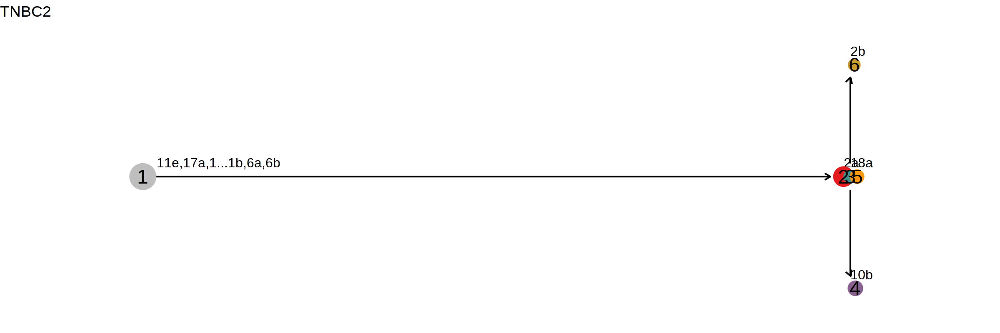

In [1476]:
E(G)$length = lapply(LLRs, sum)

G %>% plot_mut_history(clone_post = nb[[sample]]$clone_post, show_distance = TRUE, legend = F) + ggtitle(sample)

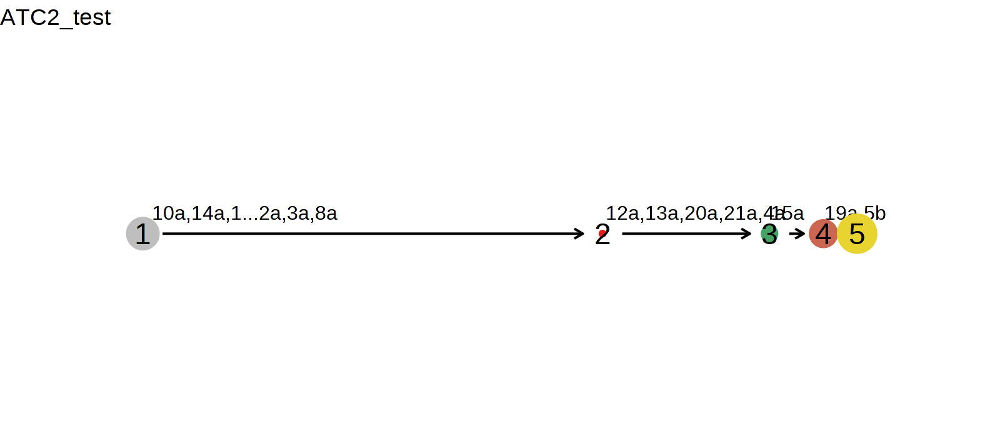

In [1430]:
E(G)$length = lapply(LLRs, sum)

G %>% plot_mut_history(clone_post = nb[[sample]]$clone_post, show_distance = TRUE, legend = F) + ggtitle(sample)

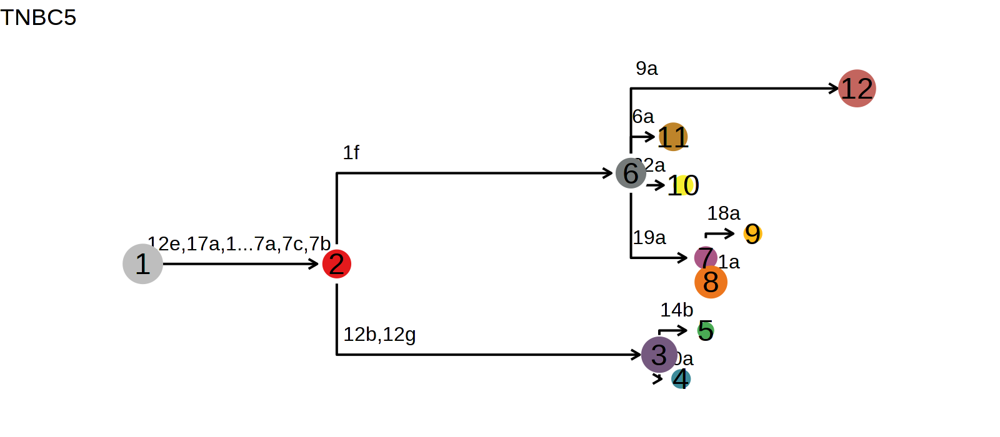

In [1416]:
E(G)$length = lapply(LLRs, sum)

G %>% plot_mut_history(clone_post = nb[[sample]]$clone_post, show_distance = TRUE, legend = F) + ggtitle(sample)

In [1342]:
library(tictoc)

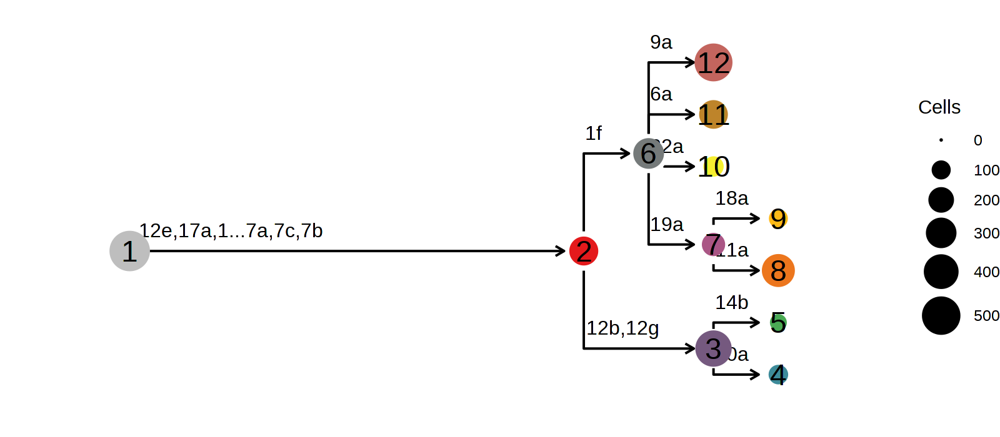

In [1273]:
nb[[sample]]$plot_mut_history()

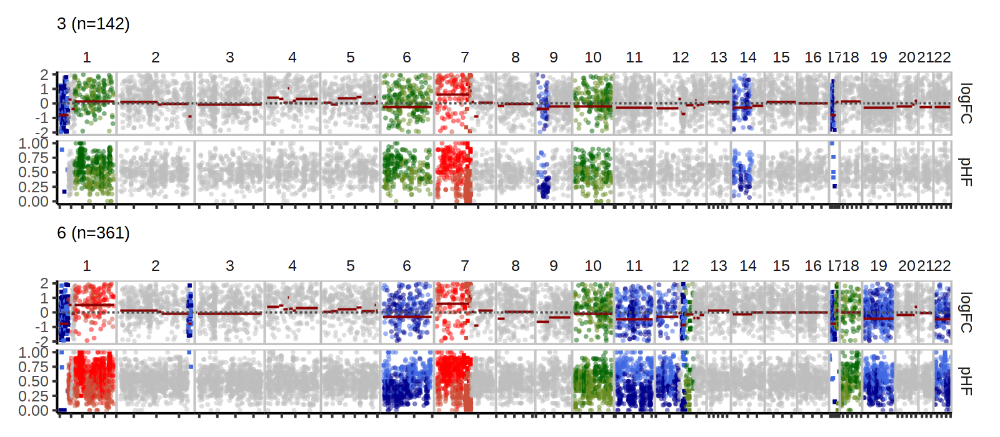

In [1276]:
options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)

sample = 'TNBC5'

segs_consensus = nb[[sample]]$segs_consensus
bulk_clones = nb[[sample]]$bulk_clones %>% filter(sample %in% c(3,6)) 

# bulk_clones = bind_rows(
#     nb[[sample]]$bulk_clones %>% filter(sample == 4),
#     nb[[sample]]$bulk_clones %>% filter(sample == 4) %>% mutate(sample = 5)
# )

bulk_clones %>% plot_bulks(min_LLR = 50)

In [1277]:
LLRs = compare_bulks(bulk_clones, segs_consensus, ncores = 20)

In [1252]:
library(parallel)

In [1052]:
R.utils::sourceDirectory('~/Numbat/R')

hmm_merged = merge_hmm(hmm1, hmm2, kernel = 'equal')
viterbi_joint2(hmm_merged)$LL

[1] -3101.14

In [1054]:
hmm_merged = merge_hmm(hmm1, hmm2, kernel = 'indep')
viterbi_joint2(hmm_merged)$LL

[1] -3085.239

In [ ]:
R.utils::sourceDirectory('~/Numbat/R')

bulk = nb[[sample]]$bulk_clones %>% filter(sample == 4) %>% analyze_bulk(t = 1e-1, diploid_chroms = c(13,14,19))

Retesting CNVs..



In [ ]:
options(repr.plot.width = 14, repr.plot.height = 2, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'TNBC1'

bulk %>% plot_bulks(phi_mle = TRUE, legend = F)

In [261]:
R.utils::sourceDirectory('~/Numbat/R')

bulks = nb[[sample]]$bulk_subtree %>% run_group_hmms(t = 1e-5, diploid_chroms = c(13,14,19))

Warning message:
“Removed 80362 rows containing missing values (geom_point).”
Warning message:
“Removed 82572 rows containing missing values (geom_point).”


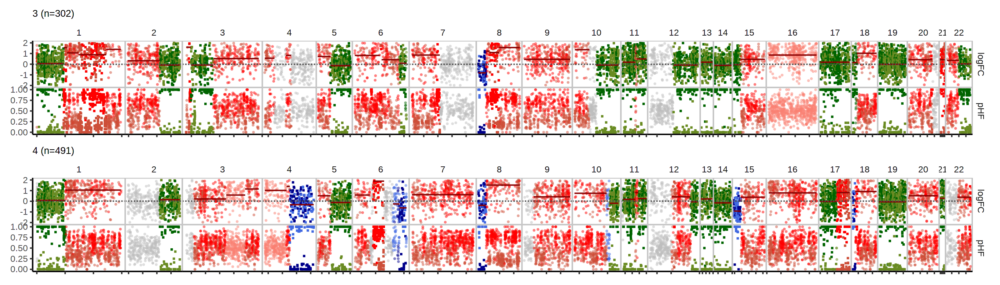

In [280]:
options(repr.plot.width = 14, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'TNBC1'

nb[[sample]]$bulk_clones %>% 
    filter(sample %in% c(3,4)) %>% 
    plot_bulks(phi_mle = TRUE, legend = F)

In [659]:
fread('~/ref/chromosome.band.hg38.txt') %>% filter(`#chrom` == 'chr15') %>% filter(gieStain == 'acen')

#chrom,chromStart,chromEnd,name,gieStain
<chr>,<int>,<int>,<chr>,<chr>
chr15,17500000,19000000,p11.1,acen
chr15,19000000,20500000,q11.1,acen


In [655]:
nb[[sample]]$segs_consensus %>% 
filter(CHROM == 15)

sample,CHROM,seg,cnv_state,cnv_state_post,seg_start,seg_end,seg_start_index,seg_end_index,theta_mle,theta_sigma,phi_mle,phi_sigma,p_loh,p_del,p_amp,p_bamp,p_bdel,LLR,LLR_y,LLR_x,n_genes,n_snps,component,LLR_sample,seg_length,seg_cons,cnv_states,n_states
<int>,<int>,<chr>,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<dbl>,<int>,<chr>,<list>,<int>
2,15,15_1,loh_2,del,22786225,57591904,44299,44782,0.3919180,0.008315930,0.7297503,0.05187467,0.01022243,9.897776e-01,4.653027e-18,0.00000e+00,0.000000e+00,461.1024,451.2808,9.821648,124,375,20,461.1024,34805679,15_1,del,1
4,15,15_2,amp_1,amp,58817580,101659107,44790,46455,0.1692637,0.006609483,1.2944761,0.07764545,0.03139212,5.188994e-09,9.686079e-01,2.24418e-56,1.202245e-64,244.8849,235.6271,9.257848,174,1396,21,244.8849,42841527,15_2,amp,1


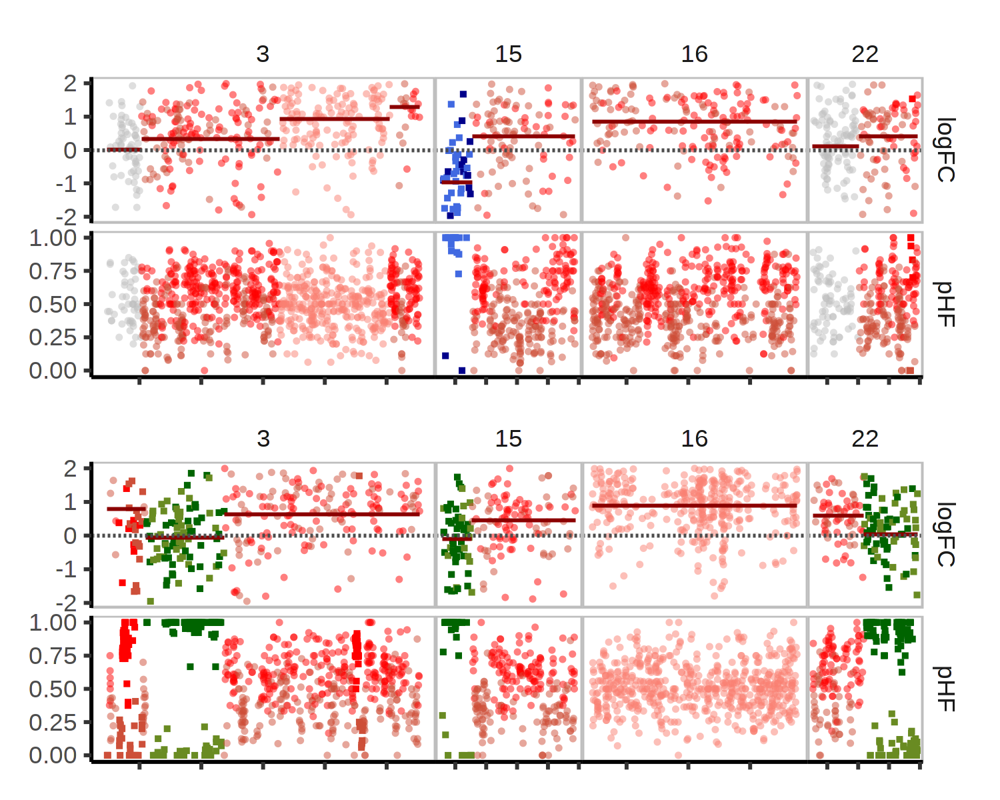

In [2433]:
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'TNBC1'

nb[[sample]]$bulk_subtrees %>% 
    filter(sample %in% c(3,4)) %>% 
    mutate(sample = factor(sample, c(4,3))) %>%
    mutate(state_post = ifelse(state_post == 'amp', 'bamp', state_post)) %>%
    filter(CHROM %in% c(3, 15, 16, 22)) %>%
    plot_bulks(phi_mle = TRUE, legend = F, use_pos = F, title = F, min_LLR = 40) %>%
    do_plot('TNBC1_segs', 5, 4)

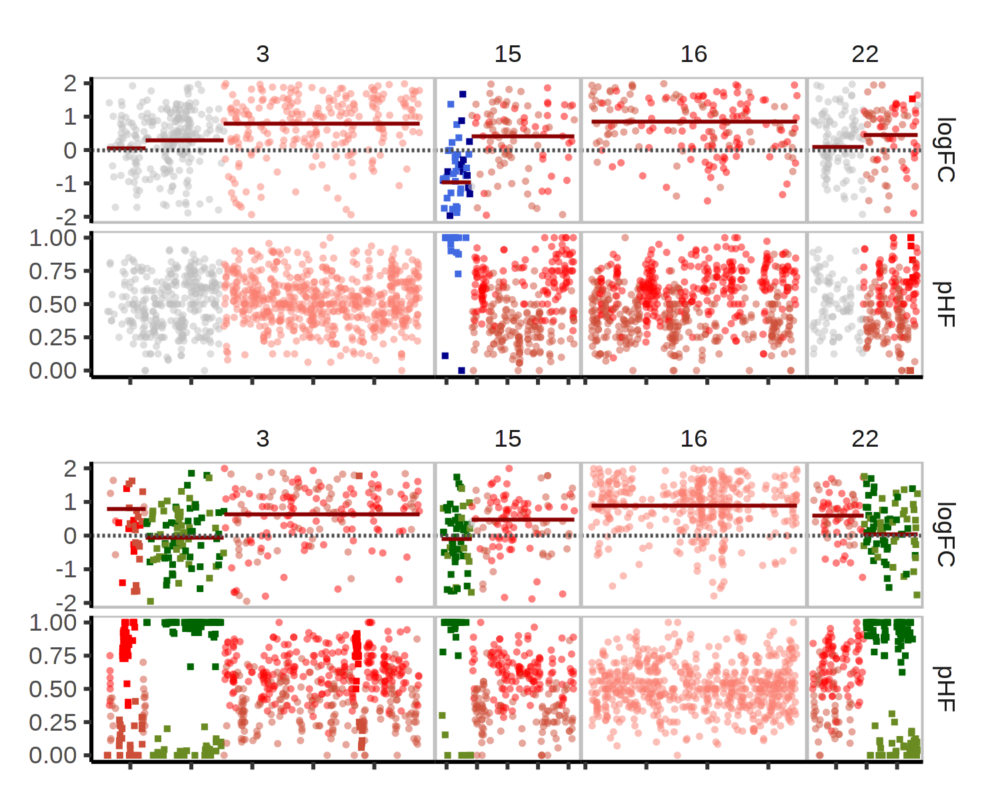

In [2443]:
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'TNBC1'

nb[[sample]]$bulk_clones %>% 
    filter(sample %in% c(3,4)) %>% 
    mutate(sample = factor(sample, c(4,3))) %>%
    mutate(state_post = ifelse(state_post == 'amp', 'bamp', state_post)) %>%
    filter(CHROM %in% c(3, 15, 16, 22)) %>%
    plot_bulks(phi_mle = TRUE, legend = F, use_pos = F, title = F, min_LLR = 40) %>%
    do_plot('TNBC1_segs', 5, 4)

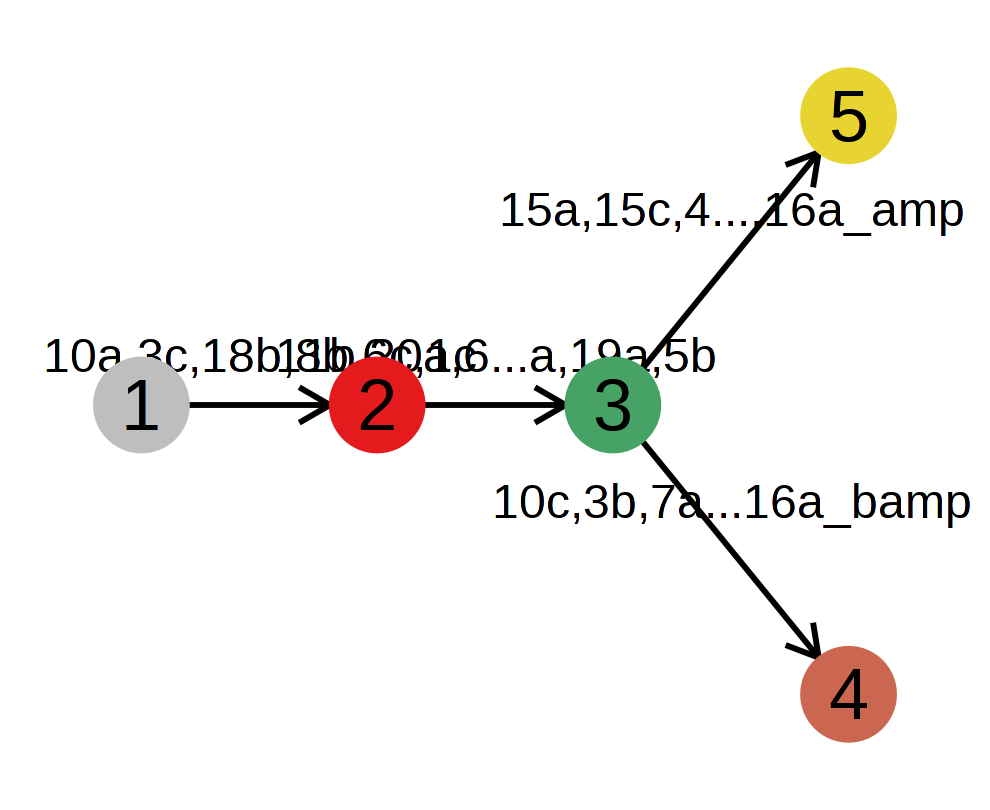

In [2441]:
nb[[sample]]$plot_mut_history()

Joining, by = "cell"
Warning message:
“Removed 3 rows containing missing values (geom_point).”


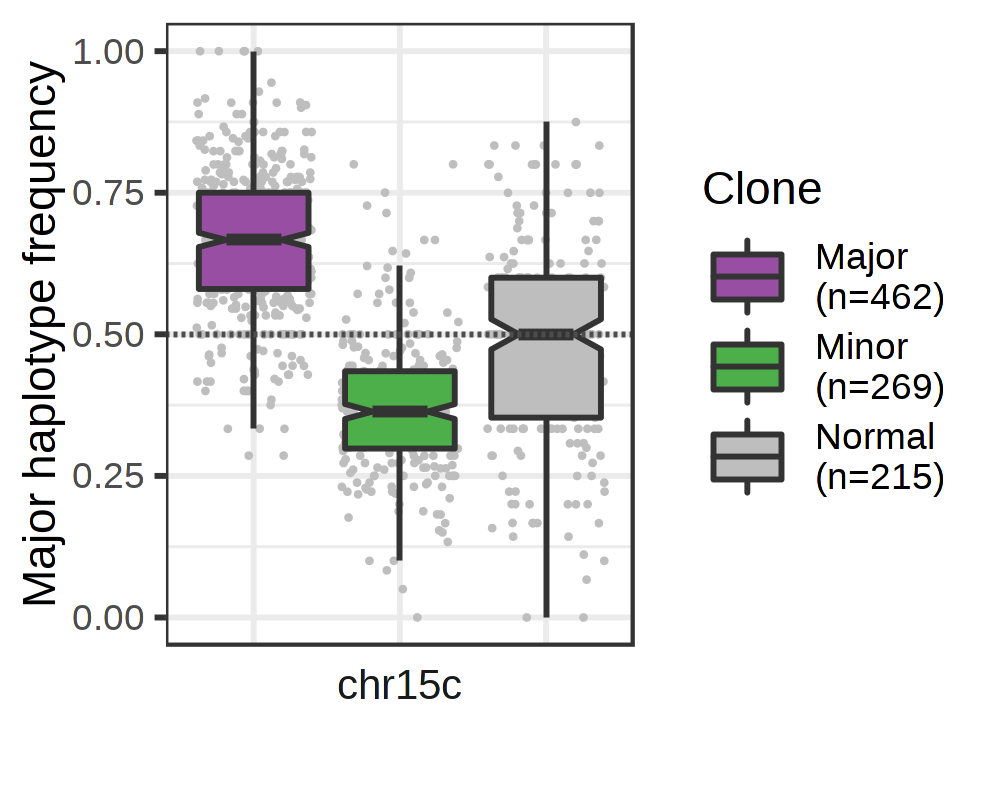

In [2449]:
options(repr.plot.width = 3.3, repr.plot.height = 2.7, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC1'
# segs = c('9_2', '15_2')
segs = c('15c')
clone_dict = c('5' = 'Major', '4' = 'Minor', '1' = 'Normal')

nb[[sample]]$allele_post %>% 
filter(seg %in% segs) %>%
mutate(seg = factor(seg, segs)) %>%
arrange(seg) %>%
rowwise() %>%
mutate(seg = paste0('chr', seg)) %>%
ungroup() %>%
mutate(seg = factor(seg, unique(seg))) %>%
left_join(
    nb[[sample]]$clone_post %>%
        select(clone = clone_opt, cell = cell)
) %>%
mutate(clone = clone_dict[as.character(clone)]) %>%
filter(!is.na(clone)) %>%
filter(total >= 5) %>%
group_by(clone) %>%
mutate(n_clone = n()) %>%
mutate(clone = glue('{clone}\n(n={n_clone})')) %>%
ungroup() %>%
ggplot(
    aes(x = clone, y = MAF, fill = clone)
) +
theme_bw() +
geom_jitter(size = 0.1, color = 'gray') +
geom_boxplot(alpha = 1, notch = T, outlier.alpha = 0) +
geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray30') +
# geom_hline(yintercept = 0.66, linetype = 'dashed', color = 'royalblue') +
# geom_hline(yintercept = 0.33, linetype = 'dashed', color = 'royalblue') +
# ggtitle('chr9') +
facet_wrap(~seg, strip.position = 'bottom') +
theme(
#     strip.background = element_rect(size = 0, fill = NULL)
    strip.background = element_blank(),
    panel.spacing = unit(0.5, 'cm'),
    strip.text = element_text(size = 10),
    axis.ticks.x = element_blank(),
    axis.text.x = element_blank(),
    plot.caption = element_text(hjust = 0)
) +
scale_fill_manual(
    values = c(pal[4], pal[3], 'gray'),
    name = 'Clone'
) +
guides(fill=guide_legend(
         keywidth=0.3,
         keyheight=0.3,
         default.unit="inch")
) +
ylim(0,1) +
ylab('Major haplotype frequency') +
xlab('')

In [140]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC1'
out_dir = glue('~/paper_data/numbat_out/{sample}')
nb[[sample]] = fetch_results(out_dir, i = 2)

In [512]:
segs_consensus = get_segs_consensus(bulk_subtrees)

In [2453]:
nb[[sample]]$segs_consensus %>% filter(CHROM == 22)

sample,CHROM,seg,cnv_state,cnv_state_post,seg_start,seg_end,seg_start_index,seg_end_index,theta_mle,⋯,LLR_y,LLR_x,n_genes,n_snps,component,LLR_sample,seg_length,seg_cons,cnv_states,n_states
<int>,<int>,<chr>,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,⋯,<dbl>,<dbl>,<int>,<int>,<int>,<dbl>,<int>,<chr>,<chr>,<int>
3,22,22a,amp_1,amp,16619607,36340520,57764,58590,0.1383400,⋯,71.91883,14.84146075,113,690,30,1091.012,19720913,22a,amp,1
NA,22,,neu,neu,36340521,36373992,NA,NA,NA,⋯,NA,NA,NA,NA,NA,NA,33471,22b,neu,0
3,22,22b,loh_2,loh,36373993,50767506,58591,59464,0.4256431,⋯,1090.97646,0.03553377,119,671,30,1091.012,14393513,22c,loh,1
NA,22,,neu,neu,50767507,50767985,NA,NA,NA,⋯,NA,NA,NA,NA,NA,NA,478,22d,neu,0


Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



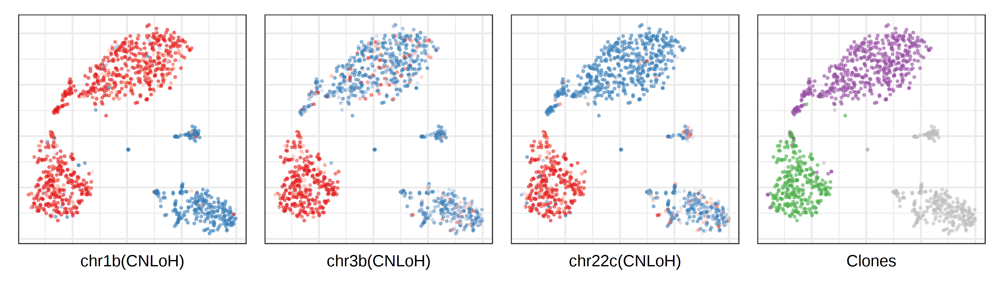

In [2456]:
options(repr.plot.width = 10.5, repr.plot.height = 3, repr.plot.res = 300)
sample = 'TNBC1'

muts = c('1b', '3b', '22c')
# cnv_states = c('22_3' = 'CNLOH', '3_3' = 'CNLOH', '4_3' = 'CNLOH', '15_1' = 'del', '1_1' = 'CNLOH')
cnv_states = nb[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}

p_clones = con_TNBC$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.5, 
    groups = nb[[sample]]$clone_post %>%
#         mutate(clone_opt = ifelse(clone_opt %in% c(5,6), 3, clone_opt)) %>%
        mutate(clone = c('1' = 'Normal', '4' = 'A', '5' = 'B')[as.character(clone_opt)]) %>%
        {setNames(.$clone, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
) +
labs(caption = 'Clones') +
scale_color_manual(values = c('Normal' = 'gray', 'A' = pal[3], 'B' = pal[4])) +
theme(plot.caption = element_text(hjust = 0.5, size = 12))

plist = list()

for (cnv in muts) {
    
    plist[[cnv]] = con_TNBC$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.5,
        plot.na = F, 
        colors = nb[[sample]]$joint_post %>%
            filter(seg == cnv) %>%
            mutate(p_cnv = ifelse(seg == '16_1', p_bamp, p_cnv)) %>%
            {setNames(.$p_cnv, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
    ) +
    scale_color_gradient2(low = pal[2], mid = 'white', midpoint = 0.5, high = pal[1], limits = c(0,1)) +
    labs(caption = paste0('chr', cnv, '(', c('amp' = 'AMP', 'loh' = 'CNLoH', 'del' = 'DEL')[cnv_states[cnv]], ')')) +
    theme(plot.caption = element_text(hjust = 0.5, size = 12))
}

plist[[length(plist) + 1]] = p_clones

wrap_plots(plist, nrow = 1, legend = 'top') %>% do_plot('TNBC1_tsne', w = 10.5, h = 3)

### Probability legend

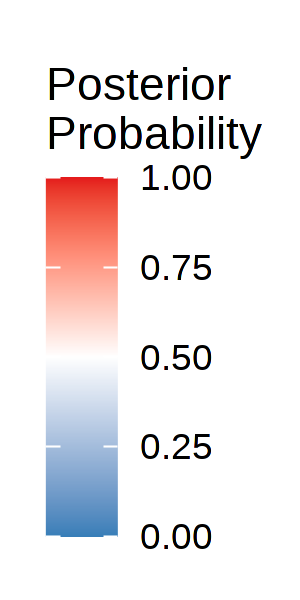

In [613]:
options(repr.plot.width = 1, repr.plot.height = 2, repr.plot.res = 300)

get_legend(
    plist[[cnv]] + theme(legend.position = 'right') +
        guides(color = guide_colorbar(title = 'Posterior\nProbability'))
) %>%
as_ggplot()

In [703]:
sample = 'TNBC1'

outdir = glue('~/paper_data/numbat_out/{sample}')
gexp.norm.long = fread(glue('{outdir}/gexp.norm.long.tsv.gz'))
hc = readRDS(glue('{outdir}/hc.rds'))

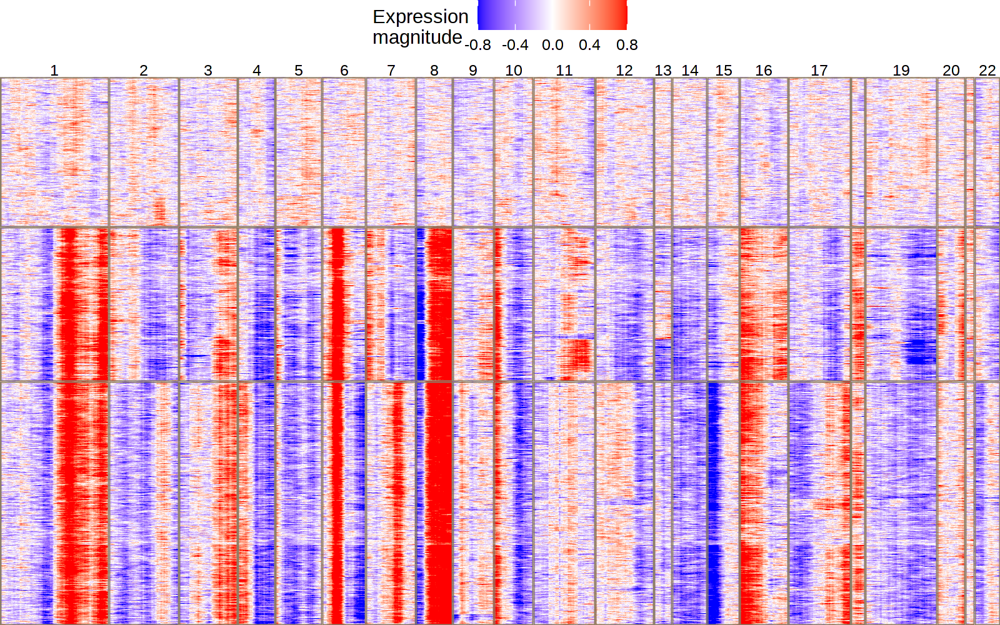

In [713]:
options(repr.plot.width = 8, repr.plot.height = 5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_roll(
    gexp.norm.long,
    hc,
    k = 3,
    n_sample = 3000,
    plot_tree = FALSE
)

Warning message:
“Removed 65 rows containing missing values (geom_point).”


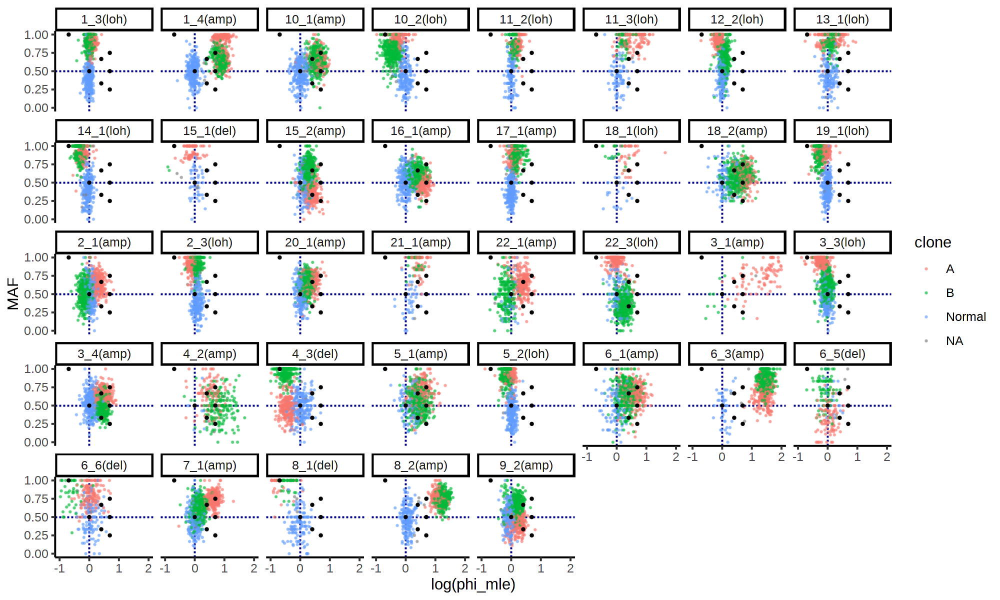

In [1591]:
options(repr.plot.width = 10, repr.plot.height = 6, repr.plot.res = 200)

D = nb[[sample]]$exp_post %>% 
    left_join(
        nb[[sample]]$allele_post %>% select(cell, seg, MAF, total),
        by = c("seg", "cell")
    ) %>%
    left_join(nb[[sample]]$clone_post, by = 'cell') %>%
    mutate(clone = c('1' = 'Normal', '4' = 'A', '5' = 'B')[as.character(clone_opt)]) %>%
    left_join(cell_annot[[sample]], by = 'cell') %>%
    mutate(clone_opt = factor(clone_opt)) 

points = data.frame(
    phi_mle = c(1, 1.5, 1.5, 0.5, 2, 2, 2),
    MAF = c(0.5, 2/3, 1/3, 1, 0.5, 0.25, 0.75)
)

ggplot(
    D %>% filter(total > 5),
    aes(x = log(phi_mle), y = MAF, color = clone)
) +
geom_vline(xintercept = 0, color = 'darkblue', linetype = 'dashed') +
geom_hline(yintercept = 0.5, color = 'darkblue', linetype = 'dashed') +
geom_point(alpha = 0.5, size = 0.2) +
theme_classic() +
facet_wrap(~seg_label, nrow = 5) +
geom_point(
    data = points,
    inherit.aes = F,
    aes(x = log(phi_mle), y = MAF),
    size = 0.5
) +
xlim(-1,2)

# TNBC5

In [80]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC5'
out_dir = glue('~/paper_data/numbat_out/{sample}_new')
nb[[sample]] = Numbat$new(out_dir, i = 2)

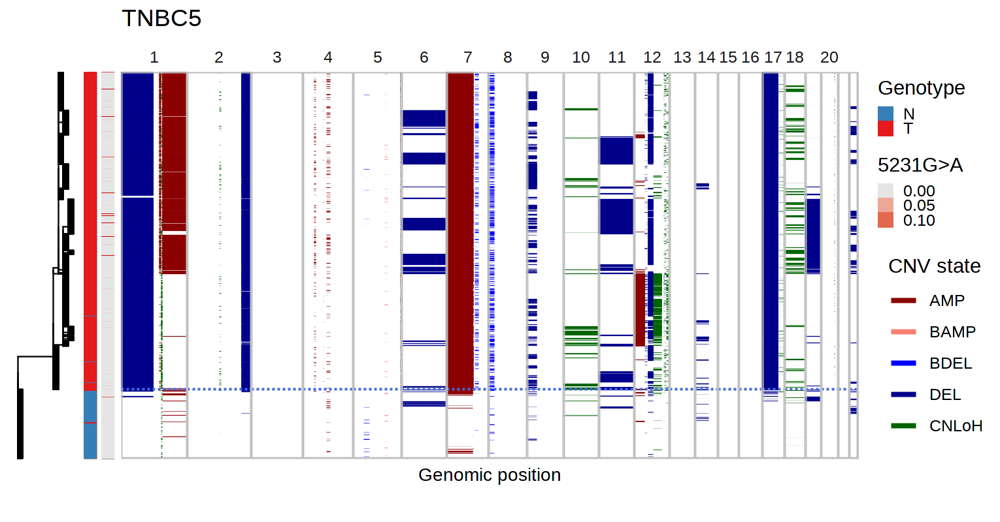

In [277]:
options(repr.plot.width = 7.65, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC5'

var = '5231G>A'

p = plot_phylo_heatmap(
    nb[[sample]]$gtree, 
    nb[[sample]]$joint_post,
    nb[[sample]]$segs_consensus,
    annot = VAF[[sample]] %>% 
        filter(variant == var) %>%
#         filter(DP >= 10) %>%
        mutate(VAF = ifelse(DP < 10, NA, VAF)) %>%
        {setNames(.$VAF, .$cell)},
    annot_scale = scale_fill_gradient(low = 'gray90', high = 'red3', limits = c(0, 0.15), na.value = 'gray90', oob = scales::squish),
    clone_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
    pal_annot = c('1' = 'red3'),
    annot_title = var,
    pal_clone = c(pal[2], pal[1]),
    tip_length = 1,
    branch_width = 0.3,
    line_width = 0.15,
    tree_height = 1.25,
    geno_bar = TRUE
) +
ggtitle(sample) &
theme(plot.background = element_rect(fill = "transparent", color = NA))

p

ggsave(glue("~/figures/{sample}_phylogeny.png"), p, bg = "transparent", width = 7.65, height = 4, dpi = 300)

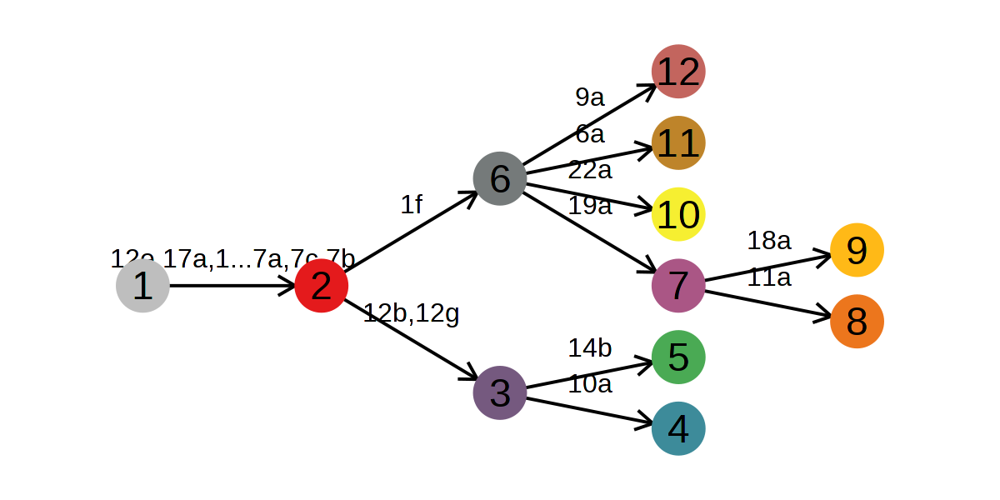

In [199]:
options(repr.plot.width = 6, repr.plot.height = 3, repr.plot.res = 200)

nb[[sample]]$plot_mut_history()

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



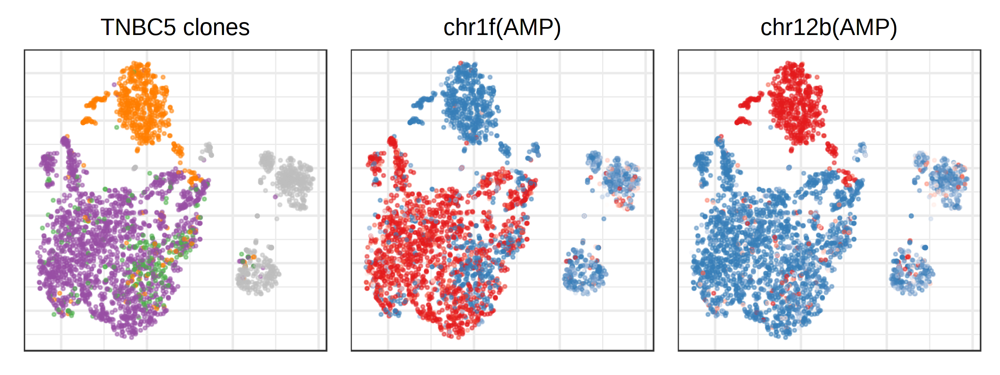

In [200]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 300)
sample = 'TNBC5'
# muts = c('1_7', '12_1')
muts = c('1f', '12b')
# cnv_states = c('22_3' = 'CNLOH', '3_3' = 'CNLOH', '4_3' = 'CNLOH', '15_1' = 'del', '1_1' = 'CNLOH')
cnv_states = nb[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}
getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 10, 'Spectral'))

p_clones = con_TNBC$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.5, 
    groups = nb[[sample]]$clone_post %>%
        mutate(clone = case_when(
            clone_opt == 1 ~ 'Normal',
#             clone_opt %in% 2 ~ 'Truncal',
#             clone_opt %in% 3:9 ~ 'Major',
#             clone_opt %in% 10:14 ~ 'Minor'
            clone_opt %in% 2 ~ 'Truncal',
            clone_opt %in% 6:12 ~ 'Major',
            clone_opt %in% 3:5 ~ 'Minor'
        )) %>%
        {setNames(.$clone, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
    title = paste0(sample, ' clones'),
#     pal = c('gray', getPalette(length(unique(nb[[sample]]$clone_post$clone_opt))-1)),
    pal = c('Normal' = 'gray', 'Truncal' = pal[3], 'Major' = pal[4], 'Minor' = pal[5])
) +
theme(plot.title = element_text(hjust = 0.5))

plist = list()
plist[[1]] = p_clones

for (mut in muts) {
    
    plist[[mut]] = con_TNBC$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.5, 
        plot.na = F, 
        colors = nb[[sample]]$joint_post %>%
            left_join(nb[[sample]]$clone_post %>% select(clone_opt, cell), by = 'cell') %>%
            filter(seg == mut) %>%
            {setNames(.$p_cnv - 0.5, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
        title = paste0('chr', mut, '(', toupper(cnv_states[mut]), ')')
#         title = mut
    ) +
    scale_color_gradient2(low = pal[2], mid = 'white', high = pal[1]) +
    theme(plot.title = element_text(hjust = 0.5))
}

wrap_plots(plist, nrow = 1, legend = 'top')

# ATC1

In [83]:
R.utils::sourceDirectory('~/Numbat/R')
sample = 'ATC1'

out_dir = glue('~/paper_data/numbat_out/{sample}_new')
nb[[sample]] = Numbat$new(out_dir, i = 2)

In [714]:
sample = 'ATC1'

outdir = glue('~/paper_data/numbat_out/{sample}')
gexp.norm.long = fread(glue('{outdir}/gexp.norm.long.tsv.gz'))
hc = readRDS(glue('{outdir}/hc.rds'))

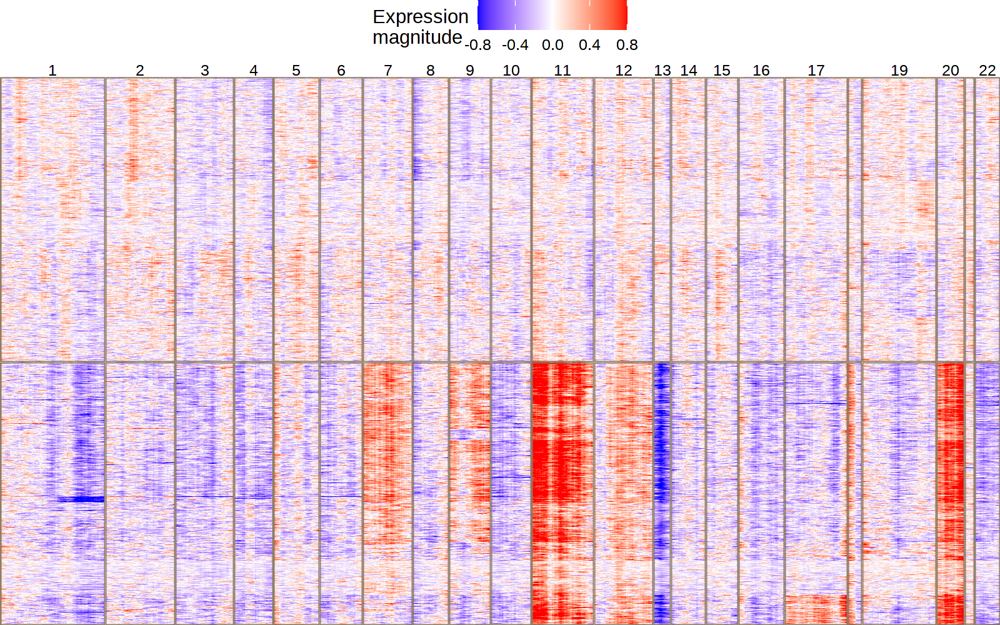

In [717]:
options(repr.plot.width = 8, repr.plot.height = 5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_roll(
    gexp.norm.long,
    hc,
    k = 2,
    n_sample = 1e4,
#     n_sample = 100,
    plot_tree = F
)

Warning message:
“Removed 157 rows containing non-finite values (stat_boxplot).”


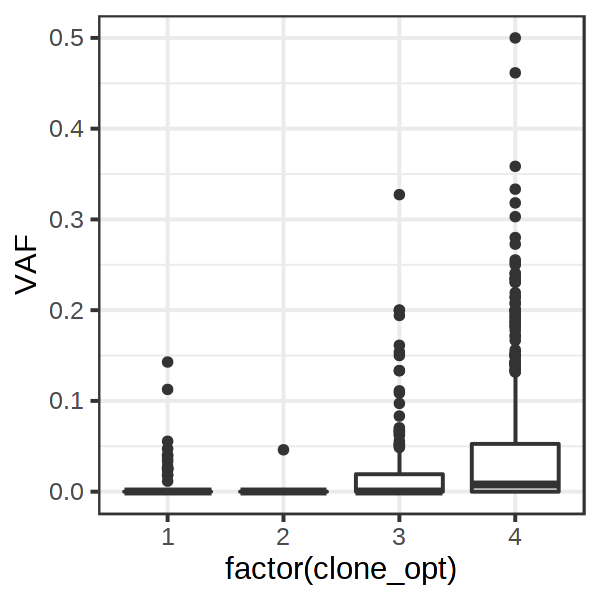

In [2164]:
options(repr.plot.width = 3, repr.plot.height = 3, repr.plot.res = 200)

sample = 'ATC1'

var = '7198G>A'

VAF[[sample]] %>% 
    filter(variant == var) %>%
    left_join(
        nb[[sample]]$clone_post,
        by = 'cell'
    ) %>%
    ggplot(
        aes(x = factor(clone_opt), y = VAF)
    ) +
    geom_boxplot(outlier.size = 1) +
#     geom_violin() +
    theme_bw() +
    coord_cartesian(ylim = c(0, 0.5))

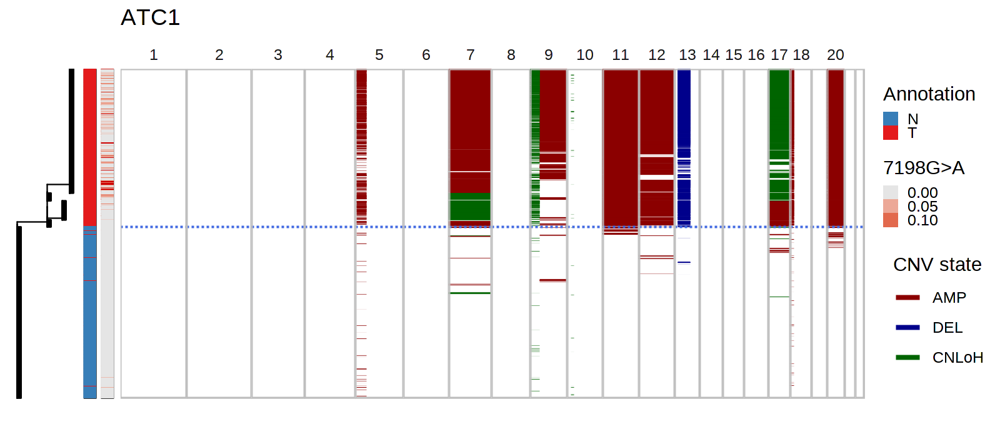

In [278]:
options(repr.plot.width = 8, repr.plot.height = 3.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC1'

var = '7198G>A'

getPalette = colorRampPalette(pal)

p = plot_phylo_heatmap(
        nb[[sample]]$gtree, 
        nb[[sample]]$joint_post,
        nb[[sample]]$segs_consensus,
        annot = VAF[[sample]] %>% 
                filter(variant == var) %>%
                mutate(VAF = ifelse(DP < 10, NA, VAF)) %>%
                {setNames(.$VAF, .$cell)},
#         pal_annot = c('1' = 'red3', '0' = 'gray90'),
        annot_scale = scale_fill_gradient(low = 'gray90', high = 'red3', limits = c(0, 0.15), na.value = 'gray90', oob = scales::squish),
        clone_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
        annot_title = var,
        pal_clone = c(pal[2], pal[1]),
        tip_length = 0.5,
        branch_width = 0.3,
        line_width = 0.15,
        geno_title = 'Annotation',
        tree_height = 1.25,
        geno_bar = TRUE
    ) +
    theme(axis.title.x = element_blank()) +
    ggtitle(sample) & 
    theme(plot.background = element_rect(fill = "transparent", color = NA)) 

ggsave(glue("~/figures/{sample}_phylogeny.png"), p, bg = "transparent", width = 8, height = 3.5, dpi = 300)

p

Retesting CNVs..

Finishing..

Warning message:
“Removed 139682 rows containing missing values (geom_point).”


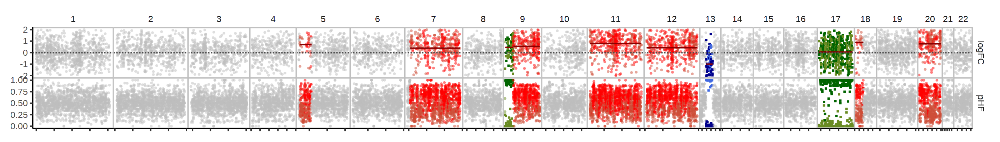

In [244]:
options(repr.plot.width = 14, repr.plot.height = 2, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

bulk = nb[[sample]]$bulk_clones %>%
    filter(sample %in% 4) %>%
    analyze_bulk(find_diploid = F, lambda = 2, t = 1e-6) 

bulk %>%
plot_bulks(phi_mle = TRUE, legend = F, title = F)

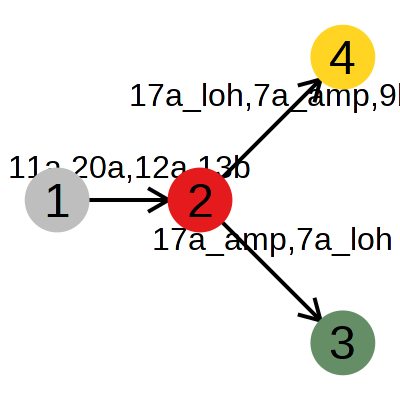

In [2469]:
options(repr.plot.width = 2, repr.plot.height = 2, repr.plot.res = 200)

nb[[sample]]$plot_mut_history()

In [2470]:
nb[[sample]]$bulk_clones %>% count(sample)

sample,n
<int>,<int>
1,70277
2,44908
3,47034
4,82009


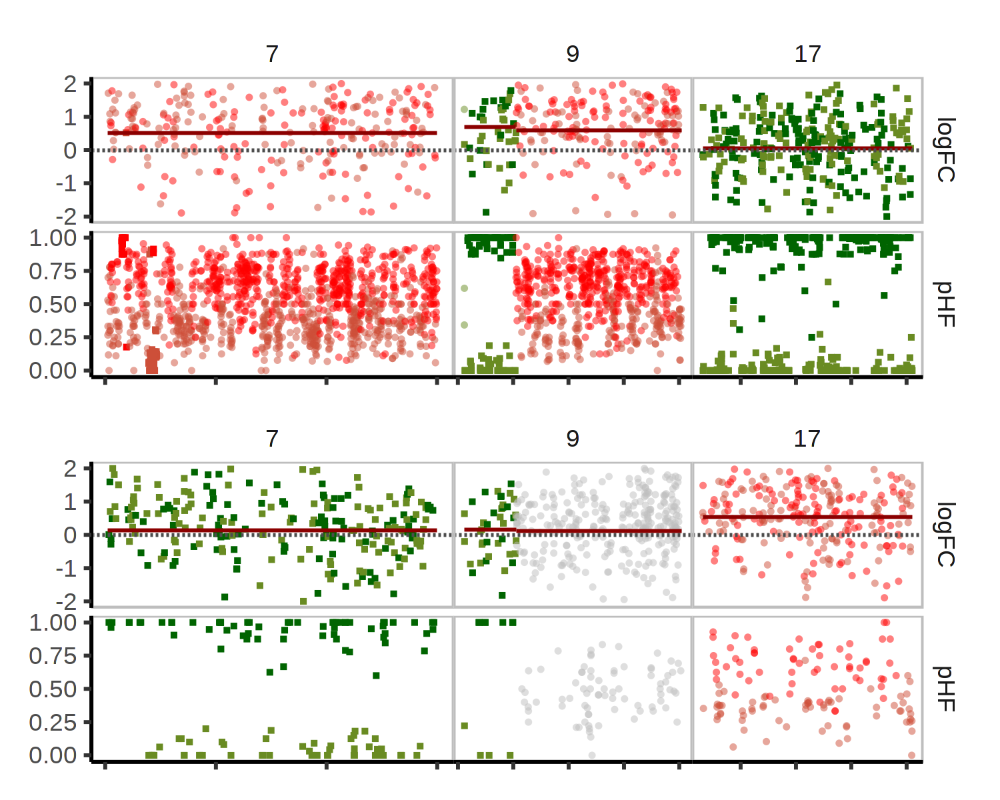

In [2478]:
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC1'
nb[[sample]]$bulk_clones %>% 
filter(sample %in% c(2,4)) %>%
mutate(sample = factor(sample, c(4,2))) %>%
filter(CHROM %in% c(7, 9, 17)) %>%
plot_bulks(phi_mle = TRUE, legend = F, title = F)

Joining, by = "cell"

Warning message:
“Removed 189 rows containing missing values (geom_point).”


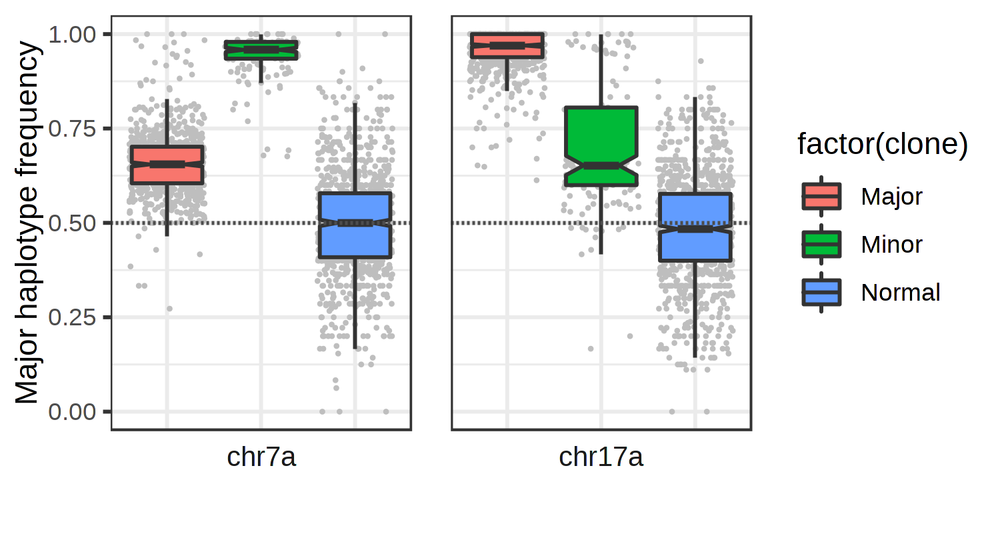

In [668]:
options(repr.plot.width = 5, repr.plot.height = 2.7, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC1'
segs = c('7_1', '17_1')
clone_dict = c('4' = 'Major', '3' = 'Minor', '1' = 'Normal')

nb[[sample]]$allele_post %>% 
filter(seg %in% segs) %>%
mutate(seg = factor(seg, segs)) %>%
arrange(seg) %>%
mutate(seg = paste0('chr', sapply(seg, function(seg) {rename_seg(seg)}))) %>%
mutate(seg = factor(seg, unique(seg))) %>%
left_join(
    nb[[sample]]$clone_post %>%
        select(clone = clone_opt, cell = cell)
) %>%
mutate(clone = clone_dict[as.character(clone)]) %>%
filter(!is.na(clone)) %>%
filter(total >= 5) %>%
ggplot(
    aes(x = clone, y = MAF, fill = factor(clone))
) +
theme_bw() +
geom_jitter(size = 0.1, color = 'gray') +
geom_boxplot(alpha = 1, notch = T, outlier.alpha = 0) +
geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray30') +
# geom_hline(yintercept = 0.66, linetype = 'dashed', color = 'royalblue') +
# geom_hline(yintercept = 0.33, linetype = 'dashed', color = 'royalblue') +
# ggtitle('chr9') +
facet_wrap(~seg, strip.position = 'bottom') +
theme(
#     strip.background = element_rect(size = 0, fill = NULL)
    strip.background = element_blank(),
    panel.spacing = unit(0.5, 'cm'),
    strip.text = element_text(size = 10),
    axis.ticks.x = element_blank(),
    axis.text.x = element_blank(),
    plot.caption = element_text(hjust = 0)
) +
# scale_fill_manual(
#     values = c('Normal' = 'gray', 'Minor' = pal[3], 'Major' = pal[4]),
#     name = 'Clone'
# ) +
ylim(0,1) +
ylab('Major haplotype frequency') +
xlab('')

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



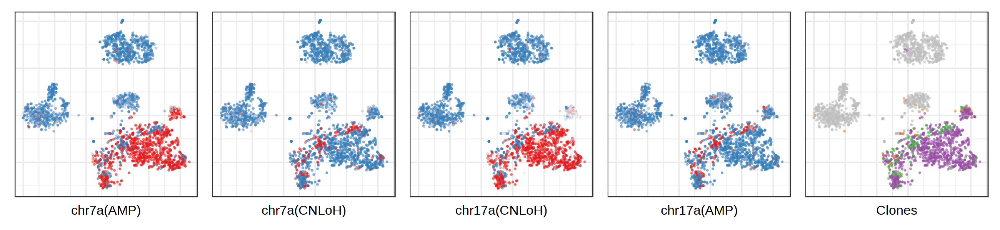

In [2477]:
options(repr.plot.width = 13, repr.plot.height = 3, repr.plot.res = 200)
sample = 'ATC1'
con_sample = con_ATC$samples[[sample]]

getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 5, 'Spectral'))

plot_list = list()

cnvs = c('7a_amp', '7a_loh', '17a_loh', '17a_amp')

for (cnv in cnvs) {

    plot_list[[cnv]] = con_sample$plotEmbedding(
            plot.na = F, 
            alpha = 0.5,
            size = 0.3,
            colors = nb[[sample]]$joint_post %>% 
                filter(seg == cnv) %>%
                {setNames(.$p_cnv, .$cell)},
            mark.groups = F,
            plot.theme = theme_bw()
        ) +
        scale_color_gradient2(low = pal[2], mid = 'white', high = pal[1], midpoint = 0.5) +
        labs(caption = paste0('chr', str_remove(cnv, '_loh|_amp'), '(', c('amp' = 'AMP', 'loh' = 'CNLoH')[str_extract(cnv, 'amp|loh')], ')')) +
        theme(plot.caption = element_text(hjust = 0.5, size = 12))
}


plot_list[[length(plot_list)+1]] = con_sample$plotEmbedding(
    plot.na = F, 
    alpha = 0.5,
    size = 0.3,
    palette = c('gray', pal[5], pal[3], pal[4]),
    groups = nb[[sample]]$clone_post %>%
        {setNames(.$clone_opt, .$cell)},
    mark.groups = F
) +
labs(caption = 'Clones') +
theme(plot.caption = element_text(hjust = 0.5, size = 12))
# guides(colour = guide_legend(override.aes = list(size = 2)))

wrap_plots(plot_list, nrow = 1)

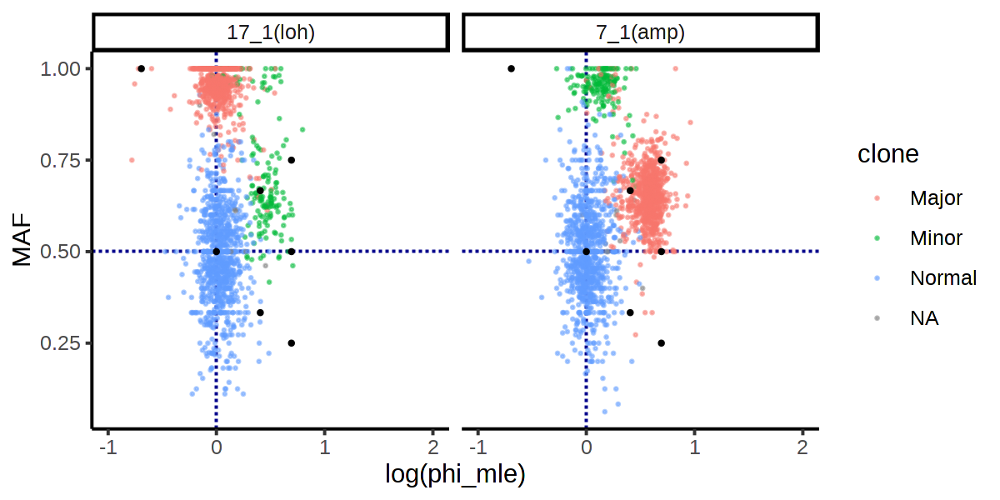

In [674]:
options(repr.plot.width = 6, repr.plot.height = 3, repr.plot.res = 200)

D = nb[[sample]]$exp_post %>% 
    filter(seg %in% segs) %>%
    left_join(
        nb[[sample]]$allele_post %>% select(cell, seg, MAF, total),
        by = c("seg", "cell")
    ) %>%
    left_join(nb[[sample]]$clone_post, by = 'cell') %>%
    mutate(clone = clone_dict[as.character(clone_opt)]) %>%
    left_join(cell_annot[[sample]], by = 'cell') %>%
    mutate(clone_opt = factor(clone_opt)) 

points = data.frame(
    phi_mle = c(1, 1.5, 1.5, 0.5, 2, 2, 2),
    MAF = c(0.5, 2/3, 1/3, 1, 0.5, 0.25, 0.75)
)

ggplot(
    D %>% filter(total >= 8),
    aes(x = log(phi_mle), y = MAF, color = clone)
) +
geom_vline(xintercept = 0, color = 'darkblue', linetype = 'dashed') +
geom_hline(yintercept = 0.5, color = 'darkblue', linetype = 'dashed') +
geom_point(alpha = 0.5, size = 0.2) +
theme_classic() +
facet_wrap(~seg_label, nrow = 1) +
geom_point(
    data = points,
    inherit.aes = F,
    aes(x = log(phi_mle), y = MAF),
    size = 0.5
) +
xlim(-1,2)

# TNBC4

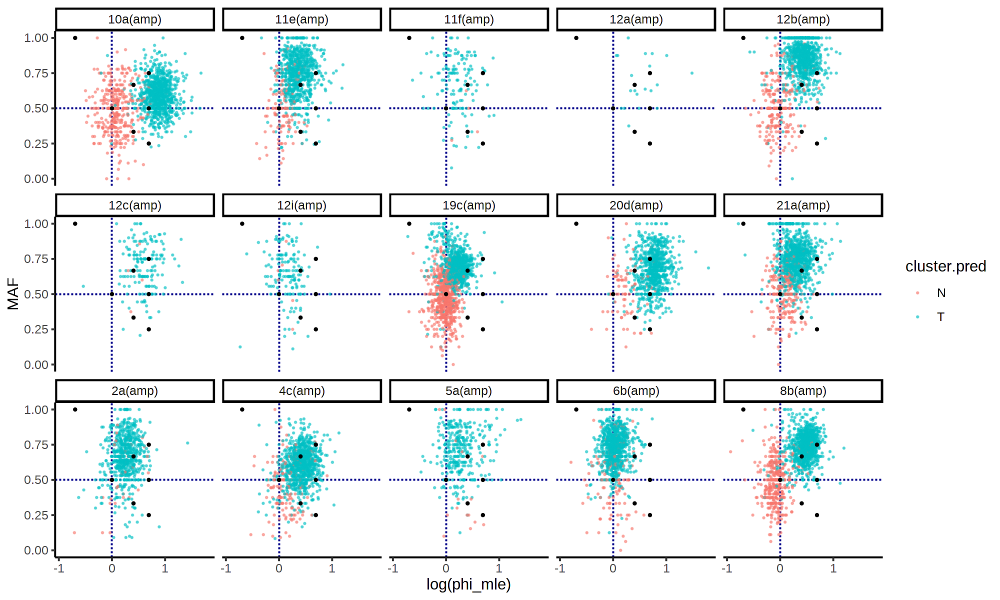

In [1078]:
options(repr.plot.width = 10, repr.plot.height = 6, repr.plot.res = 200)
sample = 'TNBC4'

D = nb[[sample]]$exp_post %>% 
    left_join(
        nb[[sample]]$allele_post %>% select(cell, seg, MAF, total),
        by = c("seg", "cell")
    ) %>%
    left_join(nb[[sample]]$clone_post, by = 'cell') %>%
    left_join(cell_annot[[sample]], by = 'cell') %>%
    mutate(clone_opt = factor(clone_opt)) 

points = data.frame(
    phi_mle = c(1, 1.5, 1.5, 0.5, 2, 2, 2),
    MAF = c(0.5, 2/3, 1/3, 1, 0.5, 0.25, 0.75)
)

ggplot(
    D %>% 
        filter(cnv_state == 'amp') %>%
        filter(total >= 8),
    aes(x = log(phi_mle), y = MAF, color = cluster.pred)
) +
geom_vline(xintercept = 0, color = 'darkblue', linetype = 'dashed') +
geom_hline(yintercept = 0.5, color = 'darkblue', linetype = 'dashed') +
geom_point(alpha = 0.5, size = 0.2) +
theme_classic() +
facet_wrap(~seg_label, nrow = 3) +
geom_point(
    data = points,
    inherit.aes = F,
    aes(x = log(phi_mle), y = MAF),
    size = 0.5
) 

notch went outside hinges. Try setting notch=FALSE.



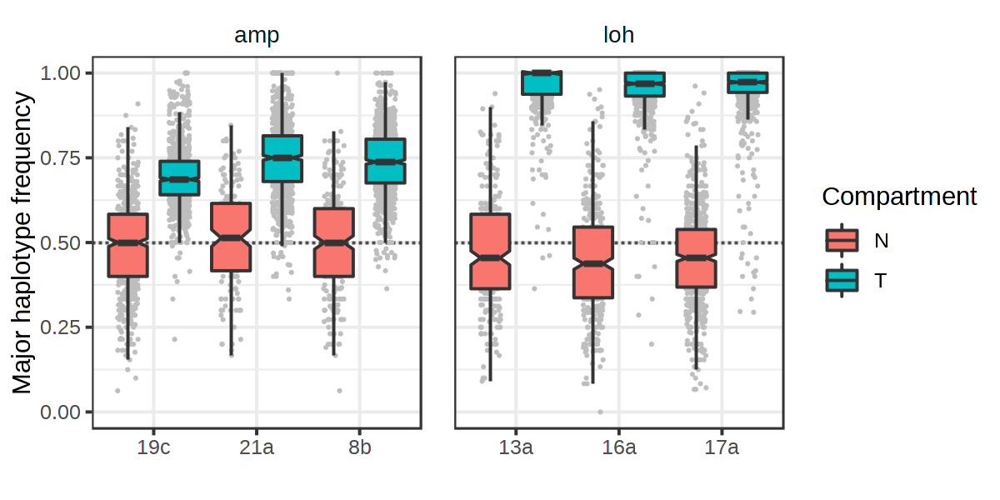

In [1663]:
options(repr.plot.width = 6, repr.plot.height = 3, repr.plot.res = 200)

chroms = c(3, 5, 9, 13:17, 22)

D %>% 
filter((cnv_state == 'amp' & CHROM %in% c(8,19,21)) | (cnv_state == 'loh' & CHROM %in% c(13,16,17))) %>%
filter(total >= 10) %>%
ggplot(
    aes(x = seg, y = MAF, fill = factor(cluster.pred))
) +
theme_bw() +
geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray30') +
# geom_hline(yintercept = 0.66, linetype = 'dashed', color = 'red') +
# geom_hline(yintercept = 0.75, linetype = 'dashed', color = 'red') +
# geom_violin(position = position_dodge(width = 1)) +
geom_jitter(size = 0.1, color = 'gray', position = position_jitterdodge(dodge.width = 1)) +
geom_boxplot(alpha = 1, notch = T, outlier.alpha = 0, position = position_dodge(width = 1)) +
theme(
    strip.background = element_blank(),
    panel.spacing = unit(0.5, 'cm'),
    strip.text = element_text(size = 10),
    plot.caption = element_text(hjust = 0)
) +
ylim(0,1) +
ylab('Major haplotype frequency') +
xlab('') +
facet_wrap(~cnv_state, scale = 'free_x') +
guides(fill = guide_legend(title = 'Compartment'))

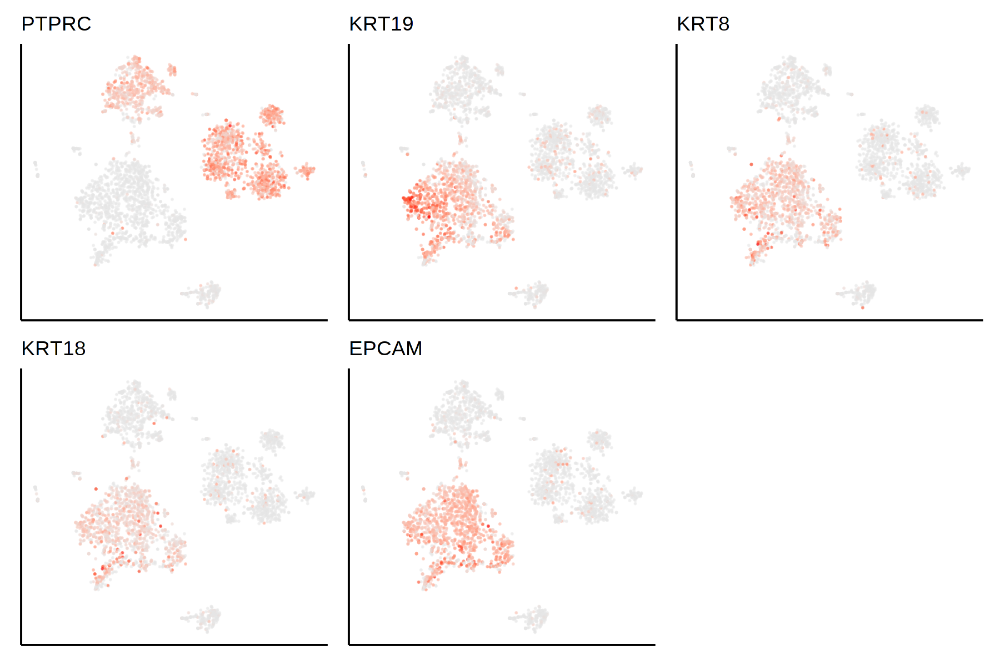

In [1135]:
options(repr.plot.width = 9, repr.plot.height = 6, repr.plot.res = 200)

sample = 'TNBC4'

con_sample = con_TNBC$samples[[sample]]

pal = RColorBrewer::brewer.pal(n = 8, 'Set1')

lapply(
    c('PTPRC', 'KRT19', 'KRT8', 'KRT18', 'EPCAM'),
    function(gene) {
        con_sample$plotEmbedding(
            plot.na = F, 
            size = 0.1,
            alpha = 0.5,
            gene = gene,
            mark.groups = F,
            title = gene,
            plot.theme = theme_classic()
        )
    }
) %>% wrap_plots(nrow = 2)

# ATC2

In [271]:
sample = 'ATC2_subsampled'
out_dir = glue('~/paper_data/numbat_out/{sample}_new')
nb[['ATC2']] = Numbat$new(out_dir, i = 2)

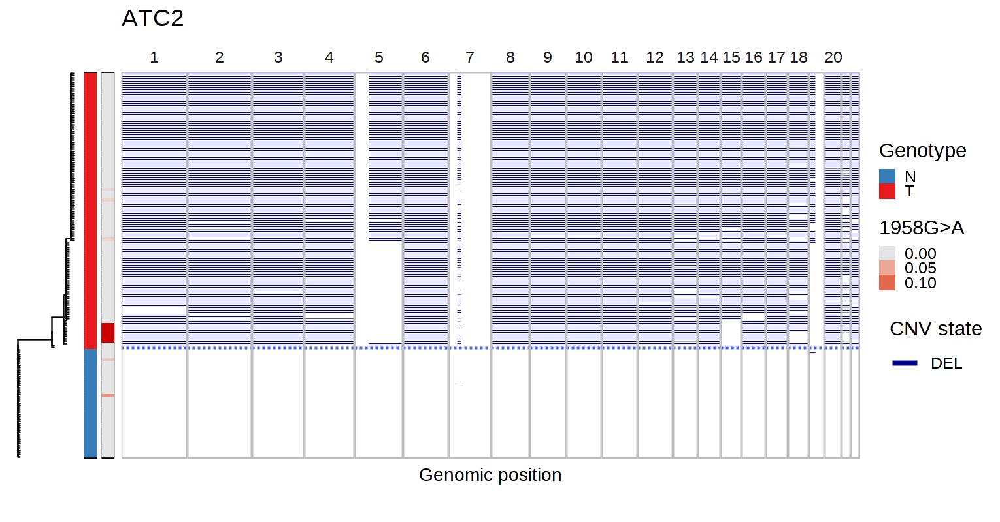

In [280]:
options(repr.plot.width = 7.65, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC2'

var = '1958G>A'

p = plot_phylo_heatmap(
    nb[[sample]]$gtree, 
    nb[[sample]]$joint_post,
    nb[[sample]]$segs_consensus,
    annot = VAF[[sample]] %>% 
        mutate(VAF = ifelse(DP < 10, NA, VAF)) %>%
        filter(variant == var) %>%
        {setNames(.$VAF, .$cell)},
    annot_scale = scale_fill_gradient(low = 'gray90', high = 'red3', limits = c(0, 0.15), na.value = 'gray90', oob = scales::squish),
    clone_dict = cell_annot[[sample]] %>% {setNames(.$cluster.pred, .$cell)},
    annot_title = var,
    pal_clone = c(pal[2], pal[1]),
    tip_length = 1,
    branch_width = 0.3,
    line_width = 0.15,
    tree_height = 1.25,
    geno_bar = TRUE
) +
ggtitle(sample) &
theme(plot.background = element_rect(fill = "transparent", color = NA))

p

ggsave(glue("~/figures/{sample}_phylogeny.png"), p, bg = "transparent", width = 7.65, height = 4, dpi = 300)

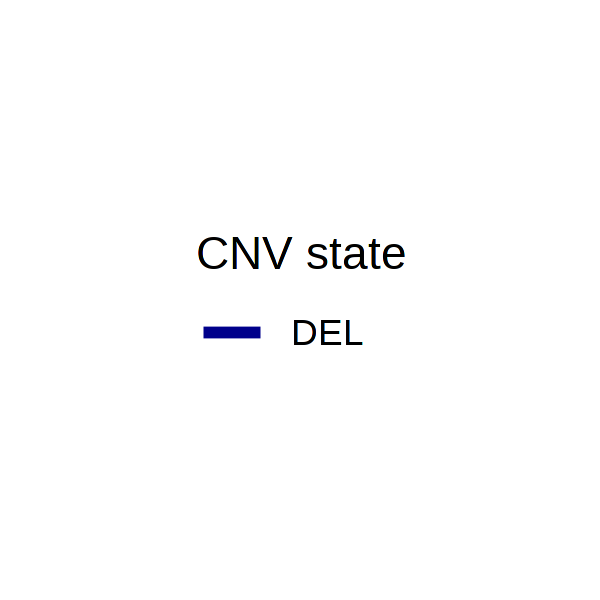

In [2412]:
options(repr.plot.width = 2, repr.plot.height = 2, repr.plot.res = 300)

ggpubr::get_legend(p) %>% 
ggpubr::as_ggplot()

In [100]:
sample = 'ATC2_subsampled'
out_dir = glue('~/paper_data/numbat_out/{sample}_new')
nb[['ATC2']] = Numbat$new(out_dir, i = 2)

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Warning message:
“Removed 1 rows containing missing values (geom_point).”


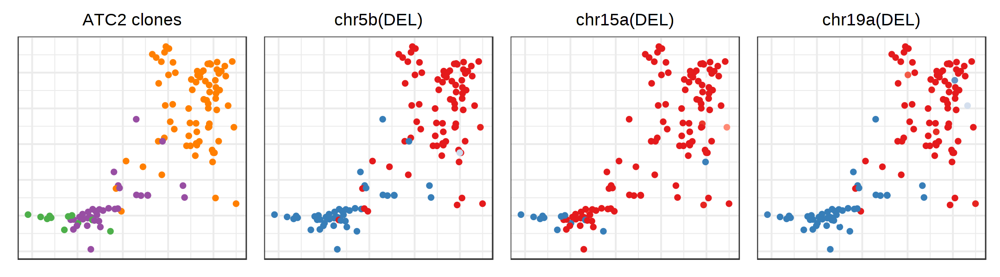

In [683]:
options(repr.plot.width = 10.8, repr.plot.height = 3, repr.plot.res = 200)
sample = 'ATC2'
muts = c('5b', '15a', '19a')
# cnv_states = c('22_3' = 'CNLOH', '3_3' = 'CNLOH', '4_3' = 'CNLOH', '15_1' = 'del', '1_1' = 'CNLOH')
cnv_states = nb[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}
getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 4, 'Spectral'))

p_clones = con_ATC$samples[[sample]]$plotEmbedding(
        alpha=1,
        size=1.5, 
    groups = nb[[sample]]$clone_post %>%
        filter(!clone_opt %in% c(1)) %>%
#         mutate(clone = c('1' = 'Normal', '4' = 'A', '5' = 'B')[as.character(clone_opt)]) %>%
        {setNames(.$clone_opt, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
    title = paste0(sample, ' clones'),
#     pal = c(getPalette(length(unique(nb[[sample]]$clone_post$clone))))
    pal = c(NA, pal[3], pal[4], pal[5])
) +
theme(plot.title = element_text(hjust = 0.5))
# scale_color_manual(values = c('Normal' = 'gray', 'A' = pal[3], 'B' = pal[4]))

plist = list()
plist[['clones']] = p_clones

for (mut in muts) {
    
    plist[[mut]] = con_ATC$samples[[sample]]$plotEmbedding(
        alpha=1,
        size=1.5, 
        plot.na = F, 
        colors = nb[[sample]]$joint_post %>%
            left_join(nb[[sample]]$clone_post %>% select(clone_opt, cell), by = 'cell') %>%
            filter(!clone_opt %in% c(1)) %>%
            filter(seg == mut) %>%
            {setNames(.$p_cnv - 0.5, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
        title = paste0('chr', str_remove(mut, '_'), '(', toupper(cnv_states[mut]), ')')
#         title = mut
    ) +
    scale_color_gradient2(low = pal[2], mid = 'white', high = pal[1]) +
    theme(plot.title = element_text(hjust = 0.5))

}

wrap_plots(plist, nrow = 1, legend = 'top')

# ATC3

In [20]:
sample = 'ATC3'
out_dir = glue('~/paper_data/numbat_out/{sample}_new')
nb[[sample]] = Numbat$new(out_dir, i = 1)

In [28]:
R.utils::sourceDirectory('~/Numbat/R')

clone_post = get_clone_post(
    nb[['ATC3']]$gtree, 
    nb[['ATC3']]$exp_post,
    nb[['ATC3']]$allele_post
)

Warning message:
“The `x` argument of `as_tibble.matrix()` must have unique column names if `.name_repair` is omitted as of tibble 2.0.0.
Using compatibility `.name_repair`.
This warning is displayed once every 8 hours.
Call `lifecycle::last_lifecycle_warnings()` to see where this warning was generated.”


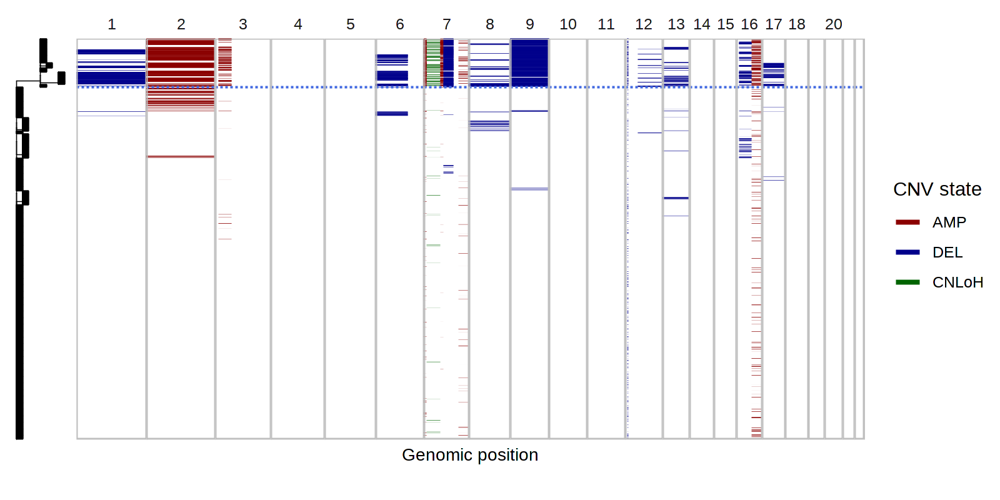

In [21]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

nb[['ATC3']]$plot_phylo_heatmap()

# ATC5

In [532]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC5'
out_dir = glue('~/paper_data/numbat_out/{sample}')
# out_dir = glue('~/results/MDA/{sample}')
nb[[sample]] = fetch_results(out_dir, i = 2)

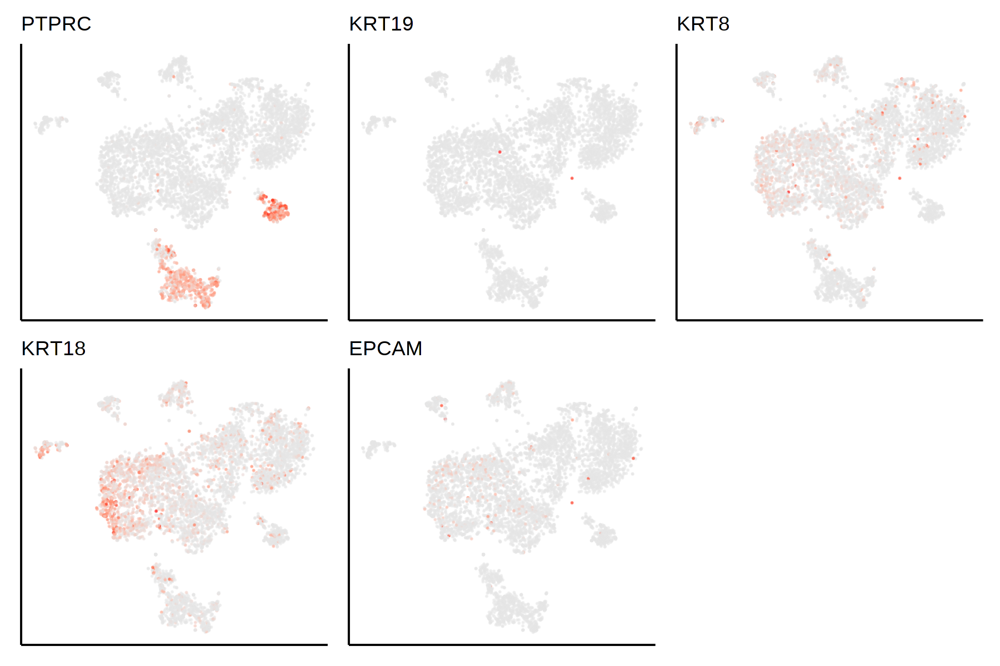

In [542]:
options(repr.plot.width = 9, repr.plot.height = 6, repr.plot.res = 200)

con_sample = con_ATC$samples[[sample]]

pal = RColorBrewer::brewer.pal(n = 8, 'Set1')

lapply(
    c('PTPRC', 'KRT19', 'KRT8', 'KRT18', 'EPCAM'),
    function(gene) {
        con_sample$plotEmbedding(
            plot.na = F, 
            size = 0.1,
            alpha = 0.5,
            gene = gene,
            mark.groups = F,
            title = gene,
            plot.theme = theme_classic()
        )
    }
) %>% wrap_plots(nrow = 2)

In [508]:
chrom_sizes = fread('~/ref/hg38.chrom.sizes.txt') %>% 
    setNames(c('CHROM', 'size')) %>%
    mutate(CHROM = str_remove(CHROM, 'chr')) %>%
    filter(CHROM %in% 1:22) %>%
    mutate(CHROM = factor(CHROM))

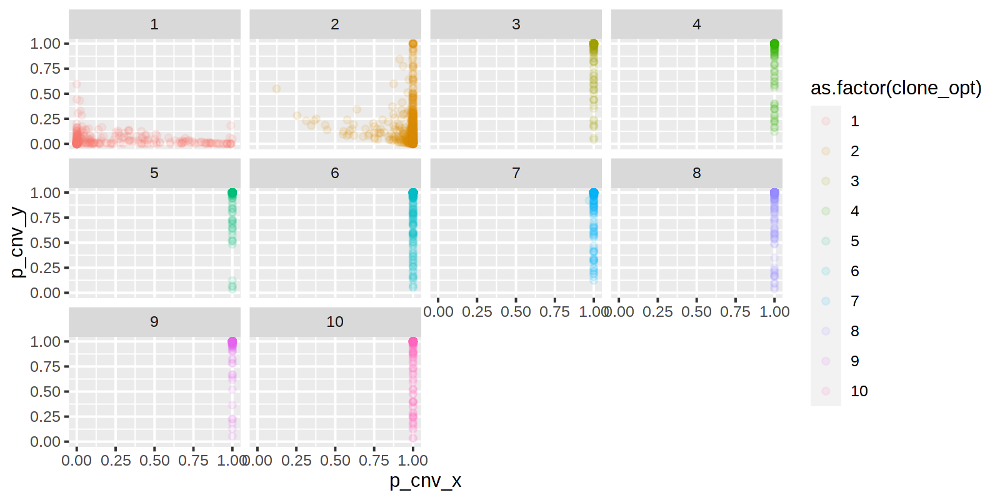

In [539]:
ggplot(
    nb[[sample]]$clone_post,
    aes(x = p_cnv_x, y = p_cnv_y, color = as.factor(clone_opt))
) +
geom_point(alpha = 0.1) +
facet_wrap(~clone_opt)

In [1596]:
# options(repr.plot.width = 8, repr.plot.height = 5, repr.plot.res = 200)
# R.utils::sourceDirectory('~/Numbat/R')

# sample = 'ATC5'

# tree_heatmap(
#     nb[[sample]]$joint_post,
#     nb[[sample]]$gtree,
#     branch_width = 0.3,
#     tip = F,
#     tip_length = 0.1,
#     ratio = 0.8,
#     tvn = F,
#     label_mut = T,
#     cnv_type = F
# ) +
# theme(plot.title = element_text(size = 8))

In [167]:
library(logger)
library(ggraph)

In [182]:
sample = 'ATC5'
tree_post = nb[[sample]]$tree_post
max_cost = 2e5

G_m = get_mut_tree(tree_post$gtree, tree_post$mut_nodes)  %>% 
    simplify_history(tree_post$l_matrix, max_cost = max_cost, verbose = T) %>% 
    label_genotype()

mut_nodes = G_m %>% igraph::as_data_frame('vertices') %>% 
    select(name = node, site = label, clone = clone, GT = GT)

# update tree
gtree = mut_to_tree(tree_post$gtree, mut_nodes)
nb[[sample]]$gtree = mark_tumor_lineage(gtree)

In [298]:
out_dir = '~/paper_data/numbat_out/ATC5'
i = 2
subtrees = readRDS(glue('{out_dir}/subtrees_{i}.rds'))

In [57]:
clone_post = fread(glue('{out_dir}/clone_post_{i}.tsv'))

# Stability

## min_overlap

In [109]:
compare_segs = function(segs_x, segs_y) {
    
    ranges_x = segs_x %>% {GenomicRanges::GRanges(
            seqnames = .$CHROM,
            IRanges::IRanges(start = .$seg_start,
                end = .$seg_end)
        )}
    
    ranges_y = segs_y %>% {GenomicRanges::GRanges(
            seqnames = .$CHROM,
            IRanges::IRanges(start = .$seg_start,
                end = .$seg_end)
        )}
    
    overlap_total = GenomicRanges::intersect(ranges_x, ranges_y) %>%
        as.data.frame() %>% pull(width) %>% sum
    
    union_total = GenomicRanges::reduce(c(ranges_x, ranges_y)) %>%
        as.data.frame() %>% pull(width) %>% sum
    
    return(overlap_total/union_total)
}

In [1140]:
overlap_samples = c('TNBC1', 'ATC1', 'TNBC5', 'ATC2')

res_overlap = list()
overlaps = as.character(c(0.15, 0.3, 0.45, 0.6, 0.75))

for (sample in overlap_samples) {
    message(sample)
    for (overlap in overlaps) {
        out_dir = glue('~/paper_data/numbat_out/{sample}_overlap_{overlap}')
        res_overlap[[sample]][[overlap]] = list()
        res_overlap[[sample]][[overlap]]$gtree = readRDS(glue('{out_dir}/tree_final_{i}.rds'))
        res_overlap[[sample]][[overlap]]$joint_post = fread(glue('{out_dir}/joint_post_{i}.tsv'))
        res_overlap[[sample]][[overlap]]$segs_consensus = fread(glue('{out_dir}/segs_consensus_{i}.tsv'))
        res_overlap[[sample]][[overlap]]$clone_post = fread(glue('{out_dir}/clone_post_{i}.tsv'))
    }
}

TNBC1

ATC1

TNBC5

ATC2



In [170]:
overlap_scores = sapply(
        overlap_samples,
        function(sample) {
            sapply(
                overlaps,
                function(overlap) {
                     compare_segs(
                        res_overlap[[sample]][[overlap]]$segs_consensus %>% filter(cnv_state != 'neu'),
                        nb[[sample]]$segs_consensus %>% filter(cnv_state != 'neu')
                    ) %>% 
                    suppressWarnings()
                }
            )
        }
    ) %>%
    as.data.frame() %>%
    mutate(overlap = overlaps) %>%
    tidyr::pivot_longer(
        cols = overlap_samples,
        names_to = 'sample',
        values_to = 'similarity'
    )

Note: Using an external vector in selections is ambiguous.
ℹ Use `all_of(overlap_samples)` instead of `overlap_samples` to silence this message.
ℹ See <https://tidyselect.r-lib.org/reference/faq-external-vector.html>.
This message is displayed once per session.


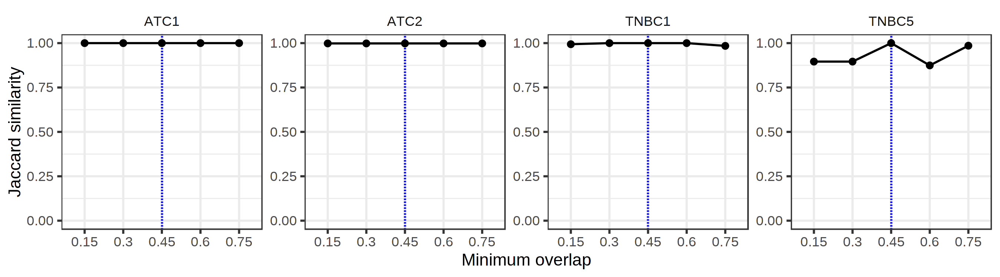

In [360]:
options(repr.plot.width = 9, repr.plot.height = 2.5, repr.plot.res = 300)

overlap_scores %>%
mutate(overlap = factor(overlap, unique(overlap))) %>%
ggplot(
    aes(x = overlap, y = similarity, group = '')
) +
geom_vline(xintercept = '0.45', linetype = 'dashed', color = 'blue') +
geom_line() +
theme_bw() +
geom_point() +
facet_wrap(~sample, scale = 'free', nrow = 1) +
ylim(0,1) +
ylab('Jaccard similarity') +
theme(
    strip.background = element_blank()
) +
xlab('Minimum overlap')

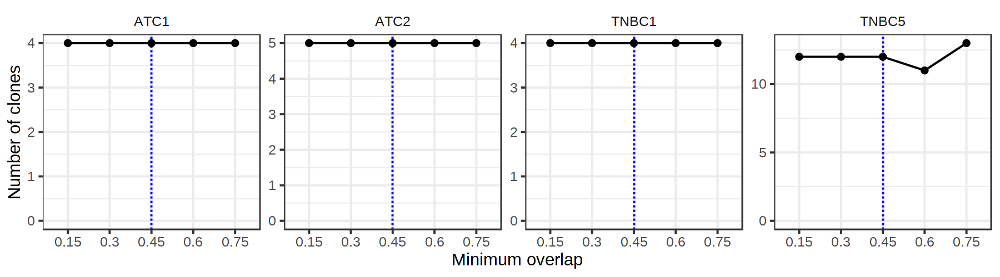

In [1184]:
options(repr.plot.width = 9, repr.plot.height = 2.5, repr.plot.res = 200)

overlap_clones = sapply(
        overlap_samples,
        function(sample) {
            sapply(
                overlaps,
                function(overlap) {
                    res_overlap[[sample]][[overlap]]$clone_post %>% pull(clone_opt) %>% unique %>% length
                }
            )
        }
    ) %>%
    as.data.frame() %>%
    mutate(overlap = overlaps) %>%
    tidyr::pivot_longer(
        cols = overlap_samples,
        names_to = 'sample',
        values_to = 'clones'
    )

overlap_clones %>%
mutate(overlap = factor(overlap, unique(overlap))) %>%
ggplot(
    aes(x = overlap, y = clones, group = '')
) +
geom_vline(xintercept = '0.45', linetype = 'dashed', color = 'blue') +
geom_line() +
theme_bw() +
geom_point() +
facet_wrap(~sample, scale = 'free', nrow = 1) +
ylim(0,NA) +
ylab('Number of clones') +
theme(
    strip.background = element_blank()
) +
xlab('Minimum overlap')

In [1140]:
sample = 'ATC3'
min_overlap = 0.45
segs = get_segs_consensus(nb[[sample]]$bulk_subtrees, min_overlap = min_overlap)

In [1161]:
chrom_sizes = fread('~/ref/hg38.chrom.sizes.txt') %>% 
    setNames(c('CHROM', 'size')) %>%
    mutate(CHROM = str_remove(CHROM, 'chr')) %>%
    filter(CHROM %in% 1:22) %>%
    mutate(CHROM = factor(CHROM))

hg38_gaps = fread('~/ref/gaps.38.txt') %>%
        setNames(c('CHROM', 'start', 'end')) %>%
        mutate(CHROM = str_remove(CHROM, 'hs')) %>%
        filter(CHROM %in% 1:22) %>%
        mutate(CHROM = as.factor(as.integer(CHROM))) %>%
        arrange(CHROM)

cnv_heatmap = function(segs) {
    
    hg38_gaps_filtered = hg38_gaps %>% filter(end - start > 1e6)
    
    ggplot(
        segs
    ) +
    geom_rect(
        data = chrom_sizes,
        aes(xmin = 0, xmax = size, ymin = -0.5, ymax = 0.5, fill = NA)
    ) +
    geom_rect(
        aes(xmin = seg_start, xmax = seg_end, ymin = -0.5, ymax = 0.5, fill = cnv_state)
    ) +
    geom_rect(
        inherit.aes = F,
        data = hg38_gaps_filtered,
        aes(xmin = start, 
            xmax = end,
            ymin = -0.5,
            ymax = 0.5),
        fill = 'white'
    ) +
    geom_rect(
        inherit.aes = F,
        data = hg38_gaps_filtered,
        aes(xmin = start, 
            xmax = end,
            ymin = -0.5,
            ymax = 0.5),
        fill = 'gray',
        alpha = 0.5
    ) +
    theme_classic() +
    theme(
        panel.spacing = unit(0, 'mm'),
        panel.border = element_rect(size = 0.5, color = 'gray', fill = NA),
        strip.background = element_blank(),
        strip.text.y = element_text(angle = 0),
        axis.text = element_blank(),
        plot.margin = margin(0, 0, 0, 0),
        axis.title.x = element_blank(),
        axis.ticks.y = element_blank()
    ) +
    facet_grid(method~CHROM, space = 'free_x', scale = 'free') +
    scale_fill_manual(values = c('neu' = 'white', cnv_colors[names(cnv_colors) != 'neu']), na.value = 'white') +
    scale_x_continuous(expand = expansion(add = 0))
}

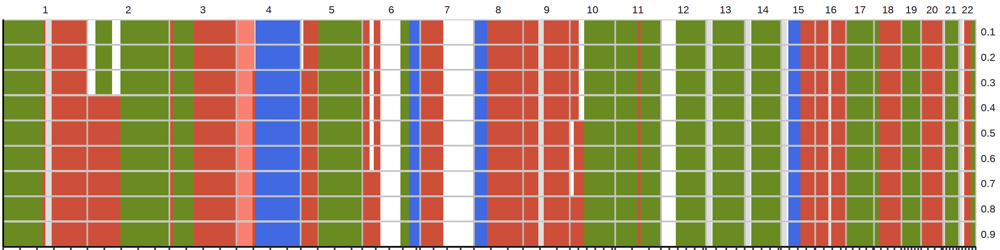

In [1177]:
options(repr.plot.width = 12, repr.plot.height = 3, repr.plot.res = 200)

segs %>% 
filter(min_overlap > 0 & min_overlap < 1) %>%
mutate(method = min_overlap, cnv_state = cnv_state_post) %>% cnv_heatmap() + guides(fill = 'none')

In [ ]:
overlap_scores = mclapply(
    mc.cores = 5,
    overlap_samples,
    function(sample) {
        message(sample)
        segs = lapply(
            seq(0,1,0.1),
            function(min_overlap) {

                segs = get_segs_consensus(nb[[sample]]$bulk_subtrees, min_overlap = min_overlap) %>%
                    filter(cnv_state != 'neu')
                
                segs_consensus = nb[[sample]]$segs_consensus %>% filter(cnv_state != 'neu')

                data.frame(
                    jac = compare_segs(segs, segs_consensus),
                    min_overlap = min_overlap,
                    sample = sample
                )
            }
        ) %>%
        bind_rows()
    }
) %>%
bind_rows()

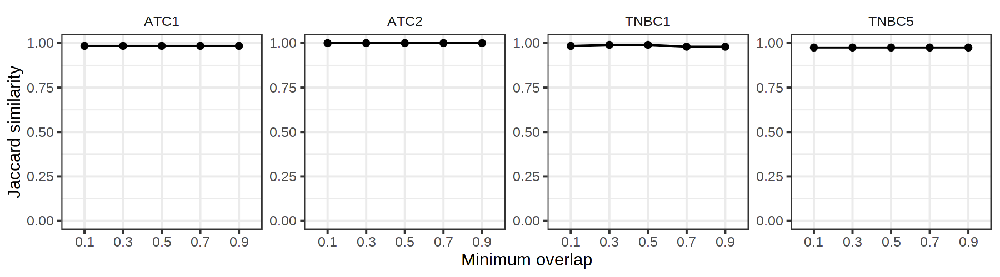

In [1944]:
options(repr.plot.width = 9, repr.plot.height = 2.5, repr.plot.res = 200)

overlap_scores %>% 
filter(min_overlap %in% seq(0.1, 0.9, 0.2)) %>%
mutate(min_overlap = factor(min_overlap)) %>%
ggplot(
    aes(x = min_overlap, y = jac, group = '')
) +
facet_wrap(~sample, nrow = 1, scale = 'free') +
geom_line() +
geom_point() +
theme_bw() +
ylim(0,1) +
ylab('Jaccard similarity') +
theme(
    strip.background = element_blank(),
) +
xlab('Minimum overlap')

## Iterations

In [1163]:
iter_samples = c('TNBC1', 'TNBC5', 'ATC1', 'ATC2')

nb_iter = c()

for (sample in iter_samples) {
    message(sample)
    out_dir = glue('~/paper_data/numbat_out/{sample}_iter')
    for (i in 1:8) {
        nb_iter[[sample]][[i]] = list()
        nb_iter[[sample]][[i]]$gtree = readRDS(glue('{out_dir}/tree_final_{i}.rds'))
        nb_iter[[sample]][[i]]$joint_post = fread(glue('{out_dir}/joint_post_{i}.tsv'))
        nb_iter[[sample]][[i]]$segs_consensus = fread(glue('{out_dir}/segs_consensus_{i}.tsv'))
        nb_iter[[sample]][[i]]$clone_post = fread(glue('{out_dir}/clone_post_{i}.tsv'))
    }
}

TNBC1

TNBC5

ATC1

ATC2



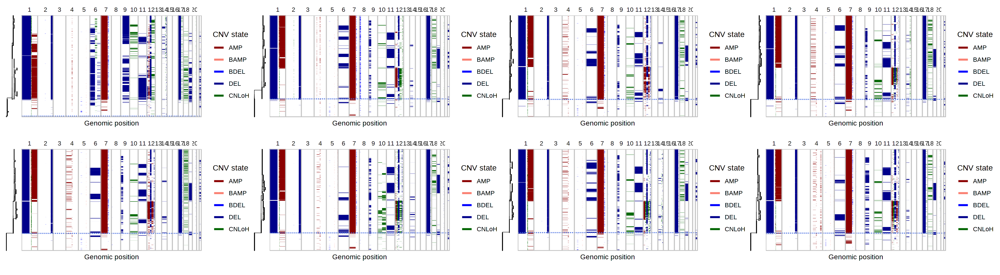

In [138]:
options(repr.plot.width = 20, repr.plot.height = 5.5, repr.plot.res = 200)

for (sample in c('TNBC5')) {
    
    lapply(
        1:8,
        function(i) {
            plot_phylo_heatmap(
                nb_iter[[sample]][[i]]$gtree,
                nb_iter[[sample]][[i]]$joint_post,
                nb_iter[[sample]][[i]]$segs_consensus
            )
        }
    ) %>%
    wrap_plots(nrow = 2) %>%
    print
    
}

In [1174]:
max_iter = 8

iter_scores = sapply(
    iter_samples,
    function(sample) {
        sapply(
            1:max_iter,
            function(i) {
                compare_segs(
                    nb_iter[[sample]][[i]]$segs_consensus %>% filter(cnv_state != 'neu'),
                    nb_iter[[sample]][[max_iter]]$segs_consensus %>% filter(cnv_state != 'neu')
                ) %>% suppressWarnings()
            }
        )
    }
) %>%
as.data.frame() %>%
mutate(i = 1:max_iter) %>%
tidyr::pivot_longer(
    cols = iter_samples,
    names_to = 'sample',
    values_to = 'similarity'
)

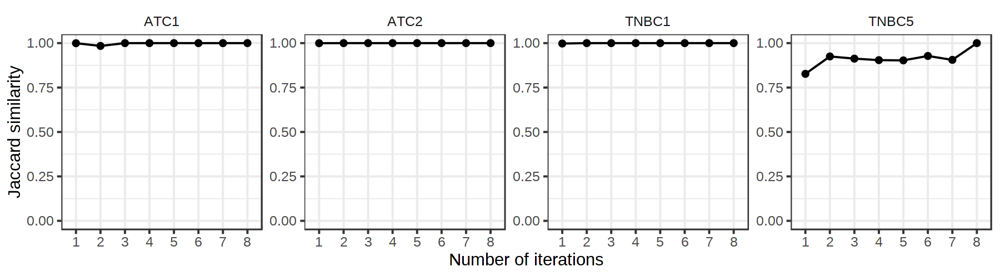

In [1175]:
options(repr.plot.width = 9, repr.plot.height = 2.5, repr.plot.res = 200)

iter_scores %>%
filter(i <= 8) %>%
mutate(i = as.factor(i)) %>%
ggplot(
    aes(x = i, y = similarity, group = '')
) +
geom_line() +
geom_point() +
theme_bw() +
facet_wrap(~sample, scale = 'free', nrow = 1) +
ylim(0,1) +
ylab('Jaccard similarity') +
theme(
    strip.background = element_blank()
) +
xlab('Number of iterations')

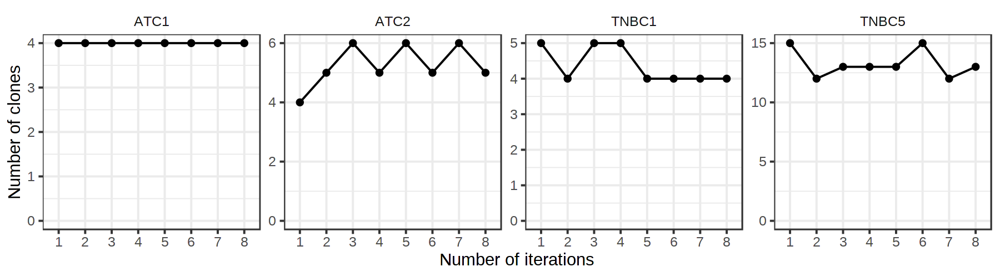

In [1185]:
options(repr.plot.width = 9, repr.plot.height = 2.5, repr.plot.res = 200)

max_iter = 8

sapply(
    iter_samples,
    function(sample) {
        sapply(
            1:max_iter,
            function(i) {
                nb_iter[[sample]][[i]]$clone_post %>% pull(clone_opt) %>% unique %>% length
            }
        )
    }
) %>%
as.data.frame() %>%
mutate(i = 1:max_iter) %>%
tidyr::pivot_longer(
    cols = iter_samples,
    names_to = 'sample',
    values_to = 'clones'
) %>%
# filter(i <= 5) %>%
mutate(i = as.factor(i)) %>%
ggplot(
    aes(x = i, y = clones, group = '')
) +
geom_vline(xintercept = '0.45', linetype = 'dashed', color = 'blue') +
geom_line() +
theme_bw() +
geom_point() +
facet_wrap(~sample, scale = 'free', nrow = 1) +
ylim(0,NA) +
ylab('Number of clones') +
theme(
    strip.background = element_blank()
) +
xlab('Number of iterations')

## Random tree

In [139]:
random_samples = c('TNBC1', 'TNBC5', 'ATC1', 'ATC2')

res_random = list()

for (sample in random_samples) {
    for (seed in 1:5) {
        res_random[[sample]][[seed]] = list()
        out_dir = glue('~/paper_data/numbat_out/{sample}_new_random_{seed}')
        for (i in 1:2) {
            res_random[[sample]][[seed]][[i]] = list()
            res_random[[sample]][[seed]][[i]]$gtree = readRDS(glue('{out_dir}/tree_final_{i}.rds'))
            res_random[[sample]][[seed]][[i]]$joint_post = fread(glue('{out_dir}/joint_post_{i}.tsv'))
            res_random[[sample]][[seed]][[i]]$segs_consensus = fread(glue('{out_dir}/segs_consensus_{i}.tsv'))
        }
    }
}

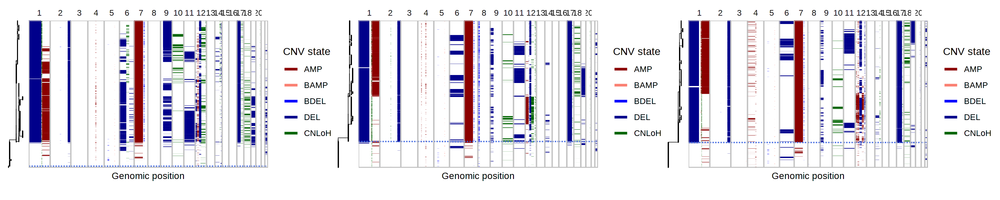

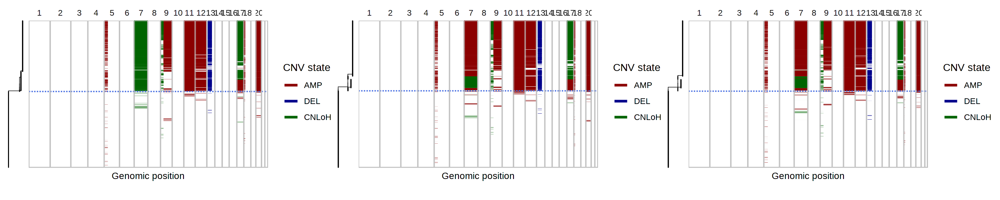

In [2327]:
options(repr.plot.width = 15, repr.plot.height = 3, repr.plot.res = 200)

for (sample in c('TNBC5', 'ATC1')) {
    
    lapply(
        1:3,
        function(seed) {
            plot_phylo_heatmap(
                nb[[sample]][[seed]]$gtree,
                nb[[sample]][[seed]]$joint_post,
                nb[[sample]][[seed]]$segs_consensus
            )
        }
    ) %>%
    wrap_plots(nrow = 1) %>%
    print
    
}

In [2328]:
# random_scores = sapply(
#         random_samples,
#         function(sample) {
#             sapply(
#                 1:3,
#                 function(seed) {
#                      compare_segs(
#                         res_random[[sample]][[seed]]$segs_consensus %>% filter(cnv_state != 'neu'),
#                         nb[[sample]]$segs_consensus %>% filter(cnv_state != 'neu')
#                     ) %>% suppressWarnings()
#                 }
#             )
#         }
#     ) %>%
#     as.data.frame() %>%
#     mutate(seed = 1:3) %>%
#     tidyr::pivot_longer(
#         cols = random_samples,
#         names_to = 'sample',
#         values_to = 'similarity'
#     )

In [140]:
random_scores = lapply(
        random_samples,
        function(sample) {
            lapply(
                1:5,
                function(seed) {
                    lapply(
                        1:2,
                        function(i) {
                            similarity = compare_segs(
                                res_random[[sample]][[seed]][[i]]$segs_consensus %>% filter(cnv_state != 'neu'),
                                nb[[sample]]$segs_consensus %>% filter(cnv_state != 'neu')
                             ) %>% suppressWarnings()

                            list(similarity = similarity, seed = seed, i = i, sample = sample)
                        }
                    ) %>% bind_rows()
                }
            ) %>% bind_rows()
        }
    ) %>%
    bind_rows() 

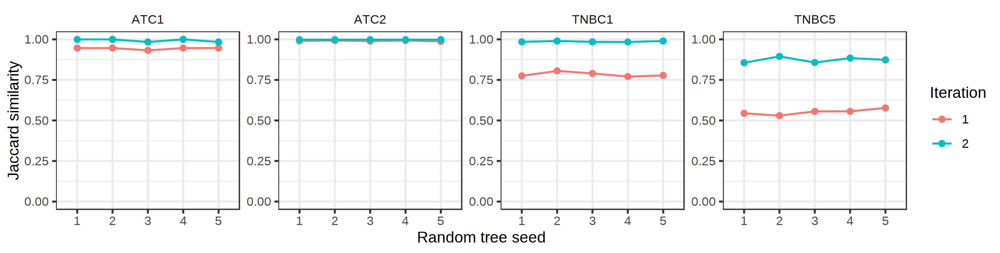

In [363]:
options(repr.plot.width = 9.88, repr.plot.height = 2.5, repr.plot.res = 300)

random_scores %>%
mutate(seed = factor(seed), i = factor(i)) %>%
ggplot(
    aes(x = seed, y = similarity, color = i, group = i)
) +
geom_line() +
geom_point() +
facet_wrap(~sample, scale = 'free', nrow = 1) +
theme_bw() +
ylim(0,1) +
ylab('Jaccard similarity') +
theme(
    strip.background = element_blank()
) +
xlab('Random tree seed') +
guides(color = guide_legend(title = 'Iteration'))

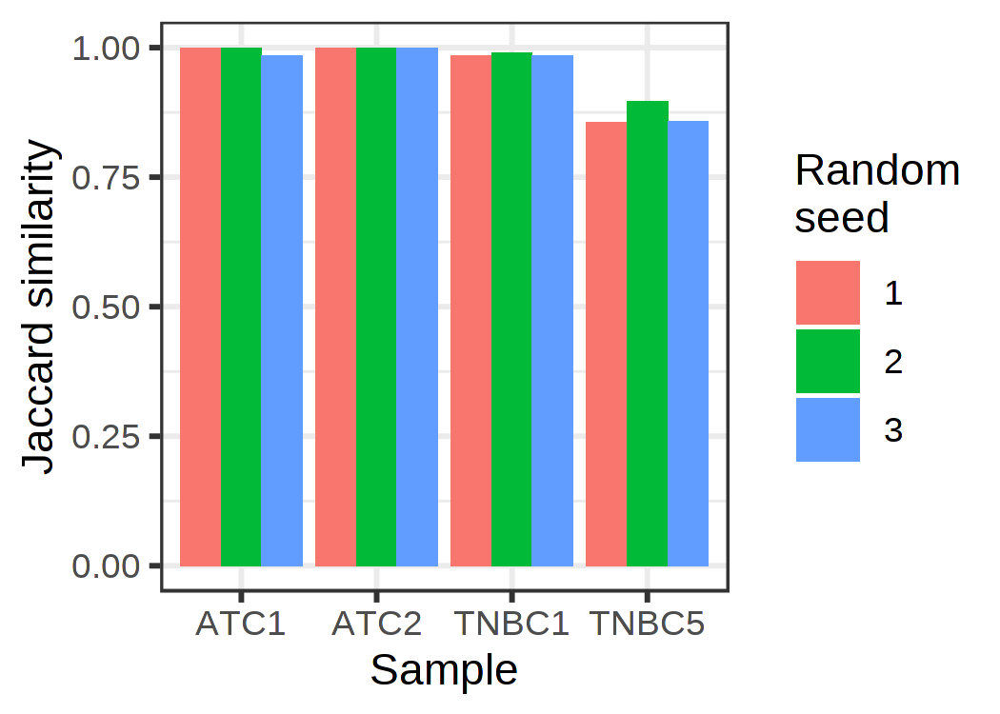

In [2353]:
options(repr.plot.width = 3.5, repr.plot.height = 2.5, repr.plot.res = 300)

random_scores %>%
mutate(seed = factor(seed)) %>%
ggplot(
    aes(x = sample, y = similarity, fill = seed)
) +
geom_col(position = position_dodge()) +
theme_bw() +
ylim(0,1) +
ylab('Jaccard similarity') +
theme(
    strip.background = element_blank()
) +
xlab('Sample') +
guides(fill = guide_legend(title = 'Random\nseed'))

In [ ]:
sample = 'ATC2'

cells_tumor = cell_annot[[sample]] %>% filter(annot == 'T') %>% pull(cell)

cells_normal = cell_annot[[sample]] %>%
    filter(annot == 'N') %>% 
    pull(cell) %>% sample(length(cells_tumor))

cells = c(cells_normal, cells_tumor)

clust = exp_hclust(
    count_mat = count_mat[[sample]][,cells],
    lambdas_ref = numbat::ref_hca[,ref_types],
    gtf_transcript = numbat::gtf_hg38,
    ncores = 10
)

In [1398]:
hc = readRDS('~/paper_data/numbat_out/ATC2/hc.rds')

sample = 'ATC2'

d = cell_annot[[sample]] %>%
    mutate(cluster = cutree(hc, k = 3)[cell]) %>%
    mutate(node = setNames(1:length(hc$labels), hc$labels)[cell], color = ifelse(cluster.pred == 'T', 'red', 'black')) %>%
    select(node, color)

In [1420]:
p_tree = ggtree(hc, layout = 'dendrogram')

In [1449]:
options(repr.plot.width = 6, repr.plot.height = 3, repr.plot.res = 200)

p_tree = ggtree(hc, layout = 'dendrogram', size = 0.1) %<+% d + aes(color=I(color)) +
    geom_tippoint(aes(color = as.factor(color)), size=1, stroke = 0.2)

p_tree$data = p_tree$data %>% mutate(color = ifelse(is.na(color), 'black', color))

In [1452]:
cell_annot[[sample]] %>%
    mutate(cluster = cutree(hc, k = 2)[cell]) %>%
    count(cluster, cluster.pred)

cluster,cluster.pred,n
<int>,<chr>,<int>
1,N,6077
1,T,20
2,T,129


In [1453]:
129/(20 + 129)

[1] 0.8657718

In [ ]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)

sample = 'TNBC1'

plot_phylo_heatmap(
    nb[[sample]]$gtree, 
    nb[[sample]]$joint_post %>%
        left_join(
            nb[[sample]]$segs_consensus %>% select(seg = seg_cons, seg_start, seg_end),
            by = 'seg'
        ) %>%
        filter(seg %in% segs),
    nb[[sample]]$segs_consensus,
    pal_annot = c('1' = 'red3'),
    annot_title = var,
    geno_bar = F
) +
ggtitle(sample)

## init_k

In [1180]:
k_samples = c('TNBC1', 'ATC2', 'TNBC5', 'ATC1')

# k_samples = c('TNBC5')

res_k = list()

for (sample in k_samples) {
    message(sample)
    for (k in 1:5) {
        out_dir = glue('~/paper_data/numbat_out/{sample}_k_{k}')
        res_k[[sample]][[k]] = list()
        for (i in 1:2) {
            res_k[[sample]][[k]][[i]] = list()
            res_k[[sample]][[k]][[i]]$gtree = readRDS(glue('{out_dir}/tree_final_{i}.rds'))
            res_k[[sample]][[k]][[i]]$clone_post = fread(glue('{out_dir}/clone_post_{i}.tsv'))
            res_k[[sample]][[k]][[i]]$joint_post = fread(glue('{out_dir}/joint_post_{i}.tsv'))
            res_k[[sample]][[k]][[i]]$segs_consensus = fread(glue('{out_dir}/segs_consensus_{i}.tsv'))
        }
    }
}

TNBC1

ATC2

TNBC5

ATC1



In [1822]:
sample = 'TNBC5'

k_trees = lapply(
    1:5,
    function(k) {
        tree = ape::as.phylo(res_k[[sample]][[k]][[2]]$gtree)
        tree$edge.length = res_k[[sample]][[k]][[2]]$gtree %>% pull(length)
        return(tree)
    }
)

class(k_trees) = "multiPhylo"

In [1854]:
clone_dict = c('1' = 'N', '2' = 'A', '3' = 'B', '4' = 'B', '5' = 'B', '6' = 'C', '7' = 'C', '8' = 'C', '9' = 'C', '10' = 'C', '11' = 'C', '12' = 'C')

clone_dict = nb[[sample]]$clone_post %>%
    mutate(clone = clone_dict[clone_opt]) %>%
    {setNames(.$clone, .$cell)}

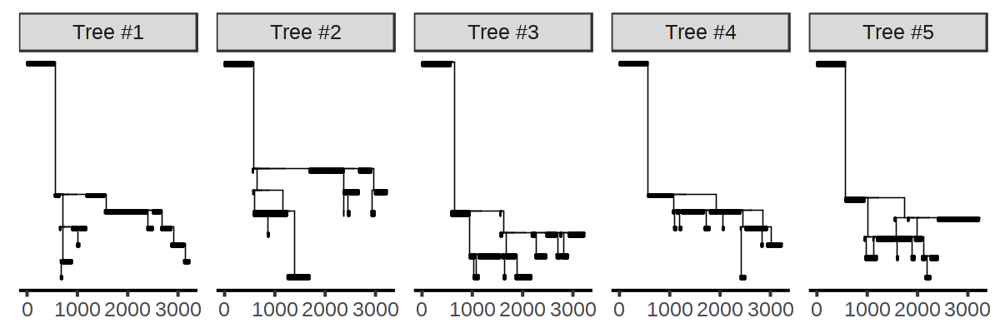

In [1871]:
options(repr.plot.width = 6, repr.plot.height = 2, repr.plot.res = 200)

ggtree(k_trees, layout = 'dendrogram', size = 0.2) + facet_wrap(~.id, scale = 'free', nrow = 1) + theme_tree2()

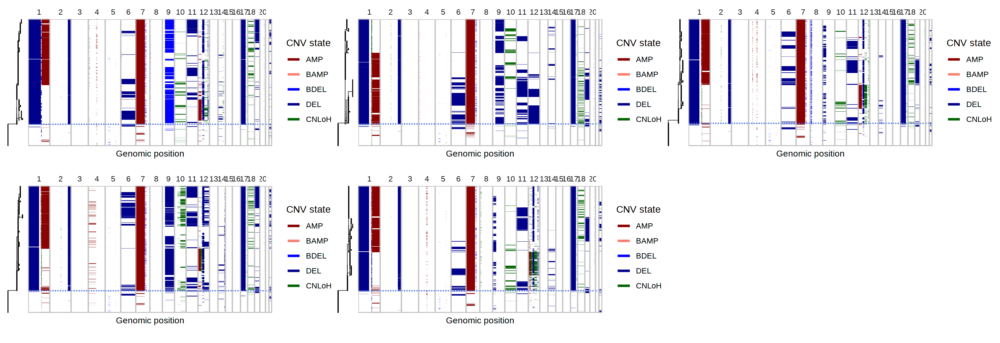

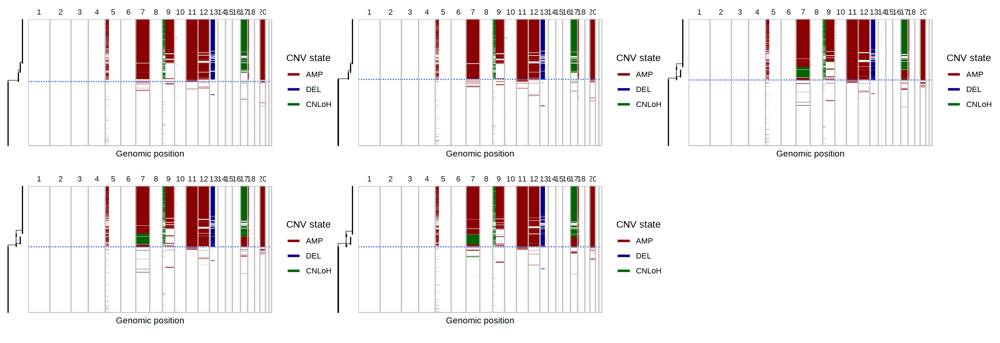

In [1770]:
options(repr.plot.width = 16, repr.plot.height = 5.5, repr.plot.res = 200)

for (sample in k_samples[3:4]) {
    
    lapply(
        1:5,
        function(k) {
            plot_phylo_heatmap(
                res_k[[sample]][[k]][[i]]$gtree,
                res_k[[sample]][[k]][[i]]$joint_post,
                res_k[[sample]][[k]][[i]]$segs_consensus
            )
        }
    ) %>%
    wrap_plots(nrow = 2) %>%
    print
    
}

In [1181]:
k_scores = mclapply(
        mc.cores = 5,
        k_samples,
        function(sample) {
            lapply(
                1:5,
                function(k) {
                    lapply(
                        1:2,
                        function(i) {
                            similarity = compare_segs(
                                res_k[[sample]][[k]][[i]]$segs_consensus %>% filter(cnv_state != 'neu'),
                                nb[[sample]]$segs_consensus %>% filter(cnv_state != 'neu')
                             ) %>% suppressWarnings()
                            
                            
                            n_clones = res_k[[sample]][[k]][[i]]$clone_post %>% pull(clone_opt) %>% unique %>% length
                            
                            list(similarity = similarity, k = k, i = i, sample = sample, n_clones = n_clones)
                        }
                    ) %>% bind_rows()
                }
            ) %>% bind_rows()
        }
    ) %>%
    bind_rows() 

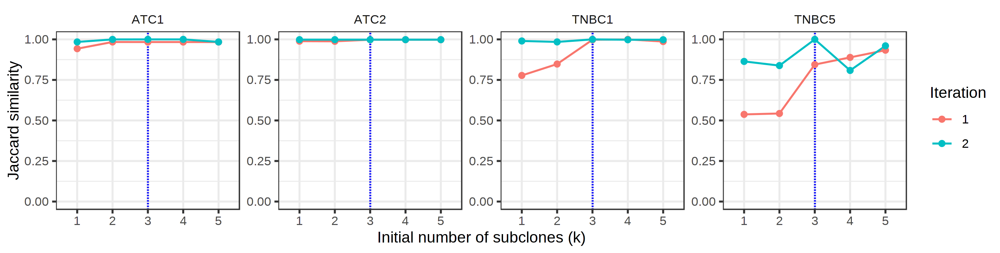

In [362]:
options(repr.plot.width = 9.88, repr.plot.height = 2.5, repr.plot.res = 300)

k_scores %>%
mutate(
    k = factor(k, unique(k)),
    i = factor(i, 1:2)
) %>%
ggplot(
    aes(x = k, y = similarity, color = i, group = i)
) +
geom_vline(xintercept = '3', linetype = 'dashed', color = 'blue') +
geom_line() +
theme_bw() +
geom_point() +
facet_wrap(~sample, scale = 'free', nrow = 1) +
ylim(0,1) +
ylab('Jaccard similarity') +
guides(color = guide_legend(title = 'Iteration')) +
theme(
    strip.background = element_blank()
) +
xlab('Initial number of subclones (k)')

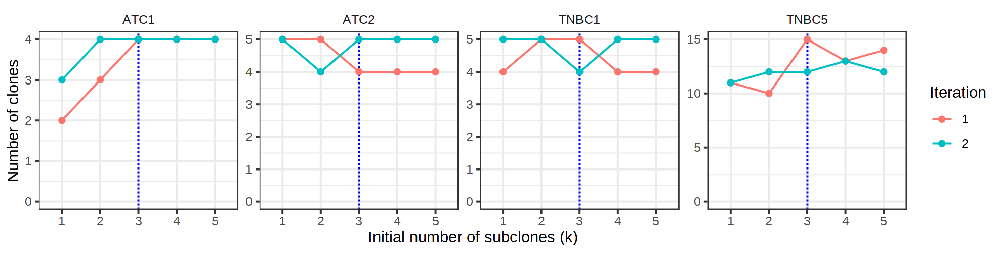

In [1182]:
options(repr.plot.width = 9.88, repr.plot.height = 2.5, repr.plot.res = 200)

k_scores %>%
mutate(
    k = factor(k, unique(k)),
    i = factor(i, 1:2)
) %>%
ggplot(
    aes(x = k, y = n_clones, color = i, group = i)
) +
geom_vline(xintercept = '3', linetype = 'dashed', color = 'blue') +
geom_line() +
theme_bw() +
geom_point() +
facet_wrap(~sample, scale = 'free', nrow = 1) +
ylim(0,NA) +
ylab('Number of clones') +
guides(color = guide_legend(title = 'Iteration')) +
theme(
    strip.background = element_blank()
) +
xlab('Initial number of subclones (k)')

## Max_cost

In [145]:
cost_samples = c('TNBC1', 'ATC2', 'ATC1', 'TNBC5')

res_cost = list()

costs = as.character(c(50, 250, 500, 750, 1000))

for (sample in cost_samples) {
    message(sample)
    for (cost in costs) {
        out_dir = glue('~/paper_data/numbat_out/{sample}_cost_{cost}')
        res_cost[[sample]][[cost]] = list()
        res_cost[[sample]][[cost]]$gtree = readRDS(glue('{out_dir}/tree_final_2.rds'))
        res_cost[[sample]][[cost]]$joint_post = fread(glue('{out_dir}/joint_post_2.tsv'))
        res_cost[[sample]][[cost]]$segs_consensus = fread(glue('{out_dir}/segs_consensus_2.tsv'))
    }
}

TNBC1

Warning message in gzfile(file, "rb"):
“cannot open compressed file '/home/tenggao/paper_data/numbat_out/TNBC1_new_cost_50/tree_final_2.rds', probable reason 'No such file or directory'”


ERROR: Error in gzfile(file, "rb"): cannot open the connection


In [113]:
cost_scores = sapply(
        cost_samples,
        function(sample) {
            sapply(
                costs,
                function(cost) {
                     compare_segs(
                        res_cost[[sample]][[cost]]$segs_consensus %>% filter(cnv_state != 'neu'),
                        nb[[sample]]$segs_consensus %>% filter(cnv_state != 'neu')
                    ) %>% suppressWarnings()
                }
            )
        }
    ) %>%
    as.data.frame() %>%
    mutate(cost = costs) %>%
    tidyr::pivot_longer(
        cols = cost_samples,
        names_to = 'sample',
        values_to = 'similarity'
    )

Note: Using an external vector in selections is ambiguous.
ℹ Use `all_of(cost_samples)` instead of `cost_samples` to silence this message.
ℹ See <https://tidyselect.r-lib.org/reference/faq-external-vector.html>.
This message is displayed once per session.


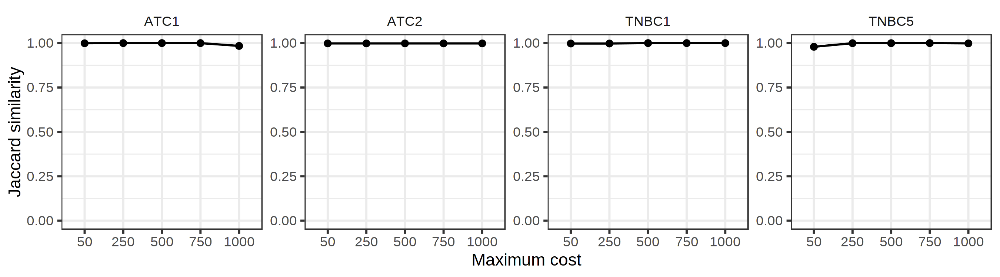

In [118]:
options(repr.plot.width = 9, repr.plot.height = 2.5, repr.plot.res = 300)

cost_scores %>%
mutate(cost = factor(cost, unique(cost))) %>%
ggplot(
    aes(x = cost, y = similarity, group = '')
) +
geom_line() +
theme_bw() +
geom_point() +
facet_wrap(~sample, scale = 'free', nrow = 1) +
ylim(0,1) +
ylab('Jaccard similarity') +
theme(
    strip.background = element_blank()
) +
xlab('Maximum cost')

In [1195]:
tau_samples = c('ATC1', 'TNBC5', 'ATC2', 'TNBC1')

res_tau = list()

taus = as.character(seq(0.1, 0.5, 0.1))

for (sample in tau_samples) {
    message(sample)
    for (tau in taus) {
        out_dir = glue('~/paper_data/numbat_out/{sample}_tau_{tau}')
        res_tau[[sample]][[tau]] = list()
        res_tau[[sample]][[tau]]$gtree = readRDS(glue('{out_dir}/tree_final_2.rds'))
        res_tau[[sample]][[tau]]$clone_post = fread(glue('{out_dir}/clone_post_2.tsv'))
        res_tau[[sample]][[tau]]$joint_post = fread(glue('{out_dir}/joint_post_2.tsv'))
        res_tau[[sample]][[tau]]$segs_consensus = fread(glue('{out_dir}/segs_consensus_2.tsv'))
    }
}

ATC1

TNBC5

ATC2

TNBC1



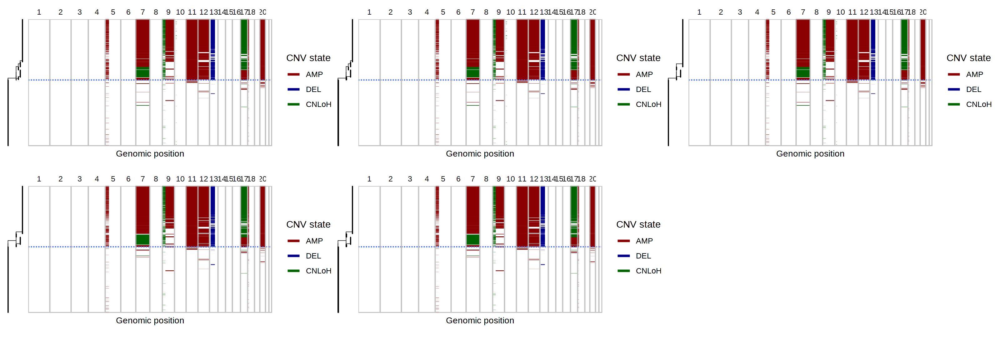

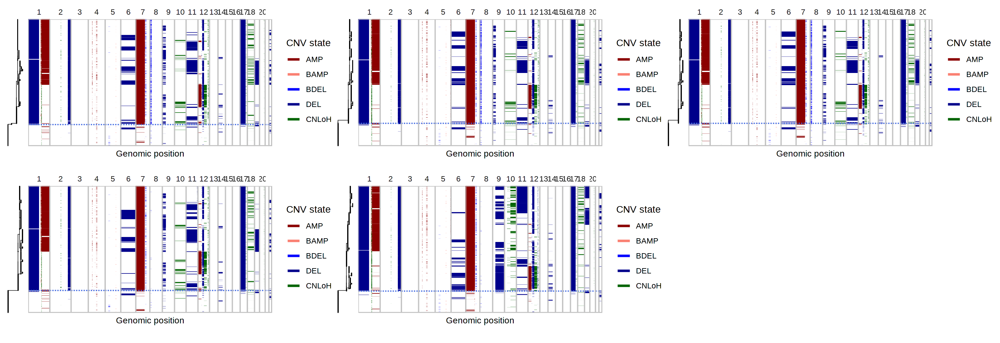

In [2236]:
options(repr.plot.width = 16, repr.plot.height = 5.5, repr.plot.res = 200)

for (sample in tau_samples) {
    
    lapply(
        taus,
        function(tau) {
            plot_phylo_heatmap(
                res_tau[[sample]][[tau]]$gtree,
                res_tau[[sample]][[tau]]$joint_post,
                res_tau[[sample]][[tau]]$segs_consensus
            )
        }
    ) %>%
    wrap_plots(nrow = 2) %>%
    print
    
}

In [1196]:
tau_scores = lapply(
        tau_samples,
        function(sample) {
            lapply(
                taus,
                function(tau) {
                     similarity = compare_segs(
                            res_tau[[sample]][[tau]]$segs_consensus %>% filter(cnv_state != 'neu'),
                            nb[[sample]]$segs_consensus %>% filter(cnv_state != 'neu')
                        ) %>% suppressWarnings()

                    n_clones = res_tau[[sample]][[tau]]$clone_post %>% pull(clone_opt) %>% unique %>% length

                    list(similarity = similarity, tau = tau, sample = sample, n_clones = n_clones)
                }
            )  %>% bind_rows()
        }
    ) %>% bind_rows()

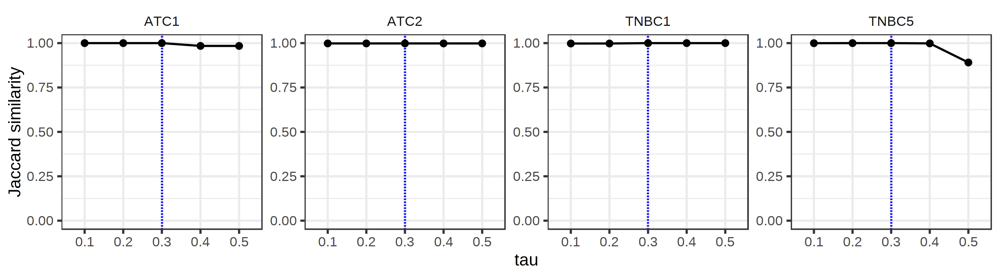

In [1188]:
options(repr.plot.width = 9, repr.plot.height = 2.5, repr.plot.res = 300)

tau_scores %>%
mutate(tau = factor(tau, unique(tau))) %>%
ggplot(
    aes(x = tau, y = similarity, group = '')
) +
geom_vline(xintercept = '0.3', linetype = 'dashed', color = 'blue') +
geom_line() +
theme_bw() +
geom_point() +
facet_wrap(~sample, scale = 'free', nrow = 1) +
ylim(0,1) +
ylab('Jaccard similarity') +
theme(
    strip.background = element_blank()
) +
xlab('tau')

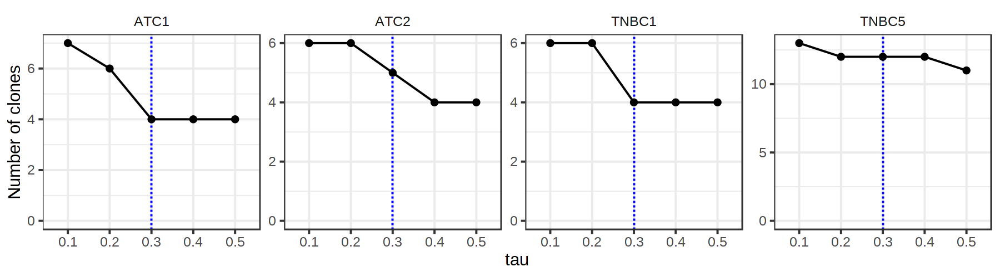

In [1197]:
options(repr.plot.width = 9, repr.plot.height = 2.5, repr.plot.res = 200)

tau_scores %>%
mutate(tau = factor(tau, unique(tau))) %>%
ggplot(
    aes(x = tau, y = n_clones, group = '')
) +
geom_vline(xintercept = '0.3', linetype = 'dashed', color = 'blue') +
geom_line() +
theme_bw() +
geom_point() +
facet_wrap(~sample, scale = 'free', nrow = 1) +
ylim(0,NA) +
ylab('Number of clones') +
theme(
    strip.background = element_blank()
) +
xlab('tau')